# Library

In [1]:
# Ignore the warnings
import warnings
# warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# System related and data input controls
import os

# Python path
import sys
base_folder = 'DataScience'
location_base = os.path.join(os.getcwd().split(base_folder)[0], base_folder)
location_module = [os.path.join(location_base, 'Module')] 
for each in location_module:
    if each not in sys.path:
        sys.path.append(each)

# Auto reload of library
%reload_ext autoreload
%autoreload 2

from import_KK import *
DeviceStrategy_CPU()
from preprocessing_KK import *
from preprocessing_text_KK import * ##
from visualization_KK import * ##
from algorithm_textmining_KK import *
from algorithm_machinelearning_KK import *
from algorithm_deeplearning_KK import *
from evaluation_KK import *

def get_data_from_path(folder_location, folder_name=False, concat_axis='row'):
    # path_folder 하위의 모든 폴더위치와 내부 file 출력
    df = pd.DataFrame()
    print('Getting data from', len(os.listdir(folder_location)), 'folders...')
    for (path, dir, files) in os.walk(folder_location):
#         print(path)
        for file in tqdm(files):
            path_file = os.path.join(path, file)

            ## 데이터 로딩
            if path_file[-4:] == 'xlsx':
                df_sub = pd.read_excel(path_file)
            elif path_file[-3:] == 'csv':
                df_sub = pd.read_csv(path_file)

            ## 키워드 태깅 여부
            if folder_name:
                df_sub['Folder_Name'] = os.path.basename(path)
            
            ## 정리
            if concat_axis == 'col':
                df = pd.concat([df, df_sub], axis=1)
            elif concat_axis == 'row':
                df = pd.concat([df, df_sub], axis=0)
                
    return df

# 하이퍼파라미터
DELETE_KEYWORD = ['100세', '거주환경']
CATEGORY_BK = ['경제', '사회', '문화', '국제']
CATEGORY_BK_Sub = ['경제>경제일반', '경제>국제경제', '경제>취업_창업',
                   '사회>노동_복지', '사회>사건_사고', '사회>사회일반', '사회>여성', '사회>장애인', '사회>의료_건강',
                   '문화>미술_건축', '문화>요리_여행', '문화>출판',
                   '국제>중국', '국제>유럽_EU', '국제>일본', '국제>미국_북미', '국제>중동_아프리카',
                   '국제>아시아', '국제>중남미', '국제>국제일반', '국제>러시아']
CATEGORY_CR = ['세계', '경제', '생활/문화', '오피니언', '사회', 'IT/과학']
IMAGE_LOCATION = os.path.join('.', 'Data', 'baby-icon_ver1.png')
COLNAME_CATEGORY = '일자'
COLNAME_MINING = '제목'
# SAVE_LOCATION = r'C:\Users\user\Desktop\Data'    # inu
SAVE_LOCATION = r'C:\Users\KK\Desktop\Data'    # home

JAVA is in the system path?:  False
JAVA is in the system path?:  Adding...


2023-11-03 22:27:31,206	INFO worker.py:1642 -- Started a local Ray instance.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


2023-11-03 22:27:50,063	INFO worker.py:1476 -- Calling ray.init() again after it has already been called.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# Data Preprocessing

## BigKinds

In [38]:
# 필터링한 결과를 최종적으로 사용
df_news = pd.read_csv(os.path.join(SAVE_LOCATION, 'df_news_bigkinds.csv'))
print('Category: ', df_news.Category.value_counts())
keyword_filter = [each for each in df_news['Folder_Name'].unique() if each not in DELETE_KEYWORD]
df_news = df_news[df_news['Folder_Name'].apply(lambda x: x in keyword_filter)].reset_index().iloc[:,1:]
category_filter = [each for each in df_news['통합 분류1'].unique() if each in CATEGORY_BK_Sub]
df_news = df_news[df_news['통합 분류1'].apply(lambda x: x in category_filter)].reset_index().iloc[:,1:]
print('Category: ', df_news.Category.value_counts())

Category:  Category
경제    182058
사회    175598
문화     96737
국제     37249
Name: count, dtype: int64
Category:  Category
사회    143555
경제     46072
국제     35535
문화     21051
Name: count, dtype: int64


## Word Frequency

In [45]:
# 불러오기
save_name_list=['wordfreq_year_soynlp.csv', 'wordfreq_year_soynlpadj.csv', 
                'wordfreq_year_tfidf.csv', 'wordfreq_year_tfidfadj.csv',
                'wordfreq_year_keybert.csv', 'wordfreq_year_keybertadj.csv']
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[0])
wf_year_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[1])
waf_year_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[2])
wf_year_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[3])
waf_year_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[4])
wf_year_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[5])
waf_year_tfidf = pd.read_csv(save_name)

# 불러오기
save_name_list=['wordfreq_era_soynlp.csv', 'wordfreq_era_soynlpadj.csv', 
                'wordfreq_era_tfidf.csv', 'wordfreq_era_tfidfadj.csv',
                'wordfreq_era_keybert.csv', 'wordfreq_era_keybertadj.csv']
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[0])
wf_era_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[1])
waf_era_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[2])
wf_era_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[3])
waf_era_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[4])
wf_era_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[5])
waf_era_tfidf = pd.read_csv(save_name)

# 불러오기
save_name_list=['wordfreq_senti_soynlp.csv', 'wordfreq_senti_soynlpadj.csv', 
                'wordfreq_senti_tfidf.csv', 'wordfreq_senti_tfidfadj.csv',
                'wordfreq_senti_keybert.csv', 'wordfreq_senti_keybertadj.csv']
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[0])
wf_senti_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[1])
waf_senti_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[2])
wf_senti_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[3])
waf_senti_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[4])
wf_senti_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq', save_name_list[5])
waf_senti_tfidf = pd.read_csv(save_name)

## Word Correlation

In [9]:
# # 불러오기
# save_name_list=['word_corrpair_soynlp_era.csv', 'wordadj_corrpair_soynlp_era.csv', 
#                 'word_corrpair_tfidf_era.csv', 'wordadj_corrpair_tfidf_era.csv']
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[0])
# wf_corr_soynlp = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[1])
# waf_corr_soynlp = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[2])
# wf_corr_tfidf = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[3])
# waf_corr_tfidf = pd.read_csv(save_name)

# save_name_list=['word_corrpair_soynlp_senti.csv', 'wordadj_corrpair_soynlp_senti.csv', 
#                 'word_corrpair_tfidf_senti.csv', 'wordadj_corrpair_tfidf_senti.csv']
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[0])
# wf_senti_corr_soynlp = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[1])
# waf_senti_corr_soynlp = pd.read_csv(save_name)
# # save_name = os.path.join(os.getcwd(), 'Data', save_name_list[2])
# # wf_senti_corr_tfidf = pd.read_csv(save_name)
# # save_name = os.path.join(os.getcwd(), 'Data', save_name_list[3])
# # waf_senti_corr_tfidf = pd.read_csv(save_name)

# 주제추출 분석

In [11]:
# 연도데이터 기준 전처리
wf_soy, waf_soy, \
wf_tf, waf_tf, \
wf_kb, waf_kb = preprocessing_wordfreq(df_news, colname_target=COLNAME_MINING, colname_category=COLNAME_CATEGORY+'_Year', 
                                       save_local=True)

  0%|                                                                                           | 0/11 [00:00<?, ?it/s]

training was done. used memory 1.032 Gbory 1.015 Gb
all cohesion probabilities was computed. # words = 11313
all branching entropies was computed # words = 19261
all accessor variety was computed # words = 19261
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 14252
_noun_scores_ 3158
after postprocessing 2137



  1%|▉                                                                             | 221/18044 [00:20<20:56, 14.18it/s]


  3%|██                                                                            | 485/18044 [00:40<22:23, 13.07it/s]


  4%|███▏                                                                          | 749/18044 [01:00<24:06, 11.95it/s]


  6%|████▎                                                                        | 1013/18044 [01:20<20:08, 14.09it/s]


  7%|█████▍                                                                       | 1277/18044 [01:39<22:15, 12.55it/s]


  9%|██████▌                                                                      | 1541/18044 [01:59<20:12, 13.61it/s]


 10%|███████▋                                                                     | 1805/18044 [02:18<22:50, 11.85it/s]


 11%|████████▊                                                                    | 2069/18044 [02:38<18:58, 14.04it/s]


 13%|█████████▉                                                                   | 2333/18044 [02:57<19:23, 13.50it/s]


 14%|███████████                                                                  | 2597/18044 [03:17<19:51, 12.96it/s]


 16%|████████████▏                                                                | 2861/18044 [03:36<18:02, 14.02it/s]


 17%|█████████████▎                                                               | 3125/18044 [03:55<17:42, 14.04it/s]


 19%|██████████████▍                                                              | 3389/18044 [04:15<19:46, 12.35it/s]


 20%|███████████████▌                                                             | 3653/18044 [04:35<18:28, 12.98it/s]


 22%|████████████████▋                                                            | 3917/18044 [04:54<18:50, 12.50it/s]


 23%|█████████████████▊                                                           | 4181/18044 [05:14<19:12, 12.03it/s]


 25%|██████████████████▉                                                          | 4445/18044 [05:34<15:22, 14.74it/s]


 26%|████████████████████                                                         | 4709/18044 [05:53<16:00, 13.88it/s]


 28%|█████████████████████▏                                                       | 4973/18044 [06:13<15:48, 13.79it/s]


 29%|██████████████████████▎                                                      | 5237/18044 [06:33<15:39, 13.63it/s]


 30%|███████████████████████▍                                                     | 5501/18044 [06:52<14:29, 14.42it/s]


 32%|████████████████████████▌                                                    | 5765/18044 [07:11<15:08, 13.51it/s]


 33%|█████████████████████████▋                                                   | 6029/18044 [07:30<14:24, 13.90it/s]


 35%|██████████████████████████▊                                                  | 6293/18044 [07:50<15:28, 12.65it/s]


 36%|███████████████████████████▉                                                 | 6557/18044 [08:09<12:29, 15.32it/s]


 38%|█████████████████████████████                                                | 6821/18044 [08:29<13:59, 13.36it/s]


 39%|██████████████████████████████▏                                              | 7085/18044 [08:49<11:37, 15.72it/s]


 41%|███████████████████████████████▎                                             | 7349/18044 [09:08<13:07, 13.58it/s]


 42%|████████████████████████████████▍                                            | 7613/18044 [09:28<12:53, 13.49it/s]


 44%|█████████████████████████████████▌                                           | 7877/18044 [09:47<10:59, 15.42it/s]


 45%|██████████████████████████████████▋                                          | 8141/18044 [10:07<12:40, 13.02it/s]


 47%|███████████████████████████████████▊                                         | 8405/18044 [10:27<12:07, 13.24it/s]


 48%|████████████████████████████████████▉                                        | 8669/18044 [10:46<10:44, 14.55it/s]


 50%|██████████████████████████████████████                                       | 8933/18044 [11:06<10:52, 13.96it/s]


 51%|███████████████████████████████████████▏                                     | 9197/18044 [11:24<10:15, 14.38it/s]


 52%|████████████████████████████████████████▎                                    | 9461/18044 [11:43<11:43, 12.20it/s]


 54%|█████████████████████████████████████████▍                                   | 9725/18044 [12:02<09:27, 14.65it/s]


 55%|██████████████████████████████████████████▋                                  | 9989/18044 [12:21<11:21, 11.82it/s]


 57%|███████████████████████████████████████████▏                                | 10253/18044 [12:41<08:46, 14.80it/s]


 58%|████████████████████████████████████████████▎                               | 10517/18044 [13:00<09:22, 13.38it/s]


 60%|█████████████████████████████████████████████▍                              | 10781/18044 [13:19<08:35, 14.10it/s]


 61%|██████████████████████████████████████████████▌                             | 11045/18044 [13:38<09:03, 12.87it/s]


 63%|███████████████████████████████████████████████▋                            | 11309/18044 [13:58<08:59, 12.49it/s]


 64%|████████████████████████████████████████████████▋                           | 11573/18044 [14:16<07:14, 14.88it/s]


 66%|█████████████████████████████████████████████████▊                          | 11837/18044 [14:35<07:41, 13.46it/s]


 67%|██████████████████████████████████████████████████▉                         | 12101/18044 [14:54<07:13, 13.72it/s]


 69%|████████████████████████████████████████████████████                        | 12365/18044 [15:13<06:55, 13.65it/s]


 70%|█████████████████████████████████████████████████████▏                      | 12629/18044 [15:32<06:15, 14.41it/s]


 71%|██████████████████████████████████████████████████████▎                     | 12893/18044 [15:51<05:46, 14.87it/s]


 73%|███████████████████████████████████████████████████████▍                    | 13157/18044 [16:11<05:57, 13.68it/s]


 74%|████████████████████████████████████████████████████████▌                   | 13421/18044 [16:30<05:19, 14.48it/s]


 76%|█████████████████████████████████████████████████████████▋                  | 13685/18044 [16:50<05:01, 14.48it/s]


 77%|██████████████████████████████████████████████████████████▊                 | 13949/18044 [17:09<05:16, 12.93it/s]


 79%|███████████████████████████████████████████████████████████▊                | 14213/18044 [17:28<04:56, 12.90it/s]


 80%|████████████████████████████████████████████████████████████▉               | 14477/18044 [17:47<04:21, 13.62it/s]


 82%|██████████████████████████████████████████████████████████████              | 14741/18044 [18:07<04:25, 12.44it/s]


 83%|███████████████████████████████████████████████████████████████▏            | 15005/18044 [18:26<03:41, 13.72it/s]


 85%|████████████████████████████████████████████████████████████████▎           | 15269/18044 [18:46<03:17, 14.08it/s]


 86%|█████████████████████████████████████████████████████████████████▍          | 15533/18044 [19:05<03:00, 13.91it/s]


 88%|██████████████████████████████████████████████████████████████████▌         | 15797/18044 [19:25<03:11, 11.75it/s]


 89%|███████████████████████████████████████████████████████████████████▋        | 16061/18044 [19:45<02:16, 14.52it/s]


 90%|████████████████████████████████████████████████████████████████████▊       | 16325/18044 [20:04<02:07, 13.48it/s]


 92%|█████████████████████████████████████████████████████████████████████▊      | 16589/18044 [20:24<01:50, 13.13it/s]


 93%|██████████████████████████████████████████████████████████████████████▉     | 16853/18044 [20:43<01:23, 14.19it/s]


 95%|████████████████████████████████████████████████████████████████████████    | 17117/18044 [21:02<01:04, 14.46it/s]


 96%|█████████████████████████████████████████████████████████████████████████▏  | 17381/18044 [21:21<00:47, 13.90it/s]


 98%|██████████████████████████████████████████████████████████████████████████▎ | 17645/18044 [21:40<00:28, 14.22it/s]


 99%|███████████████████████████████████████████████████████████████████████████▍| 17909/18044 [21:59<00:10, 12.96it/s]


  9%|███████▏                                                                       | 1/11 [22:21<3:43:39, 1341.95s/it]

training was done. used memory 1.119 Gbory 1.099 Gb
all cohesion probabilities was computed. # words = 13589
all branching entropies was computed # words = 21894
all accessor variety was computed # words = 21894
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 16563
_noun_scores_ 3809
after postprocessing 2521



  1%|▉                                                                             | 260/20833 [00:19<26:01, 13.18it/s]


  3%|█▉                                                                            | 524/20833 [00:39<26:24, 12.82it/s]


  4%|██▉                                                                           | 788/20833 [01:00<26:29, 12.61it/s]


  5%|███▉                                                                         | 1052/20833 [01:19<24:40, 13.36it/s]


  6%|████▊                                                                        | 1316/20833 [01:39<24:10, 13.46it/s]


  8%|█████▊                                                                       | 1580/20833 [01:59<24:54, 12.88it/s]


  9%|██████▊                                                                      | 1844/20833 [02:19<21:52, 14.47it/s]


 10%|███████▊                                                                     | 2108/20833 [02:38<21:44, 14.36it/s]


 11%|████████▊                                                                    | 2372/20833 [02:58<22:37, 13.60it/s]


 13%|█████████▋                                                                   | 2636/20833 [03:18<21:37, 14.03it/s]


 14%|██████████▋                                                                  | 2900/20833 [03:37<23:40, 12.62it/s]


 15%|███████████▋                                                                 | 3164/20833 [03:57<23:31, 12.52it/s]


 16%|████████████▋                                                                | 3428/20833 [04:17<22:36, 12.83it/s]


 18%|█████████████▋                                                               | 3692/20833 [04:37<25:00, 11.42it/s]


 19%|██████████████▌                                                              | 3956/20833 [04:56<21:41, 12.97it/s]


 20%|███████████████▌                                                             | 4220/20833 [05:16<19:19, 14.32it/s]


 22%|████████████████▌                                                            | 4484/20833 [05:36<21:37, 12.60it/s]


 23%|█████████████████▌                                                           | 4748/20833 [05:56<22:01, 12.17it/s]


 24%|██████████████████▌                                                          | 5012/20833 [06:16<21:07, 12.48it/s]


 25%|███████████████████▌                                                         | 5276/20833 [06:36<19:28, 13.32it/s]


 27%|████████████████████▍                                                        | 5540/20833 [06:56<19:27, 13.09it/s]


 28%|█████████████████████▍                                                       | 5804/20833 [07:16<16:57, 14.78it/s]


 29%|██████████████████████▍                                                      | 6068/20833 [07:36<19:09, 12.85it/s]


 30%|███████████████████████▍                                                     | 6332/20833 [07:55<16:35, 14.57it/s]


 32%|████████████████████████▍                                                    | 6596/20833 [08:15<16:03, 14.78it/s]


 33%|█████████████████████████▎                                                   | 6860/20833 [08:35<17:24, 13.37it/s]


 34%|██████████████████████████▎                                                  | 7124/20833 [08:55<16:54, 13.51it/s]


 35%|███████████████████████████▎                                                 | 7388/20833 [09:14<18:41, 11.99it/s]


 37%|████████████████████████████▎                                                | 7652/20833 [09:34<17:32, 12.53it/s]


 38%|█████████████████████████████▎                                               | 7916/20833 [09:54<14:56, 14.41it/s]


 39%|██████████████████████████████▏                                              | 8180/20833 [10:13<15:24, 13.69it/s]


 41%|███████████████████████████████▏                                             | 8444/20833 [10:33<16:10, 12.77it/s]


 42%|████████████████████████████████▏                                            | 8708/20833 [10:53<14:57, 13.51it/s]


 43%|█████████████████████████████████▏                                           | 8972/20833 [11:14<13:59, 14.13it/s]


 44%|██████████████████████████████████▏                                          | 9236/20833 [11:34<14:40, 13.17it/s]


 46%|███████████████████████████████████                                          | 9500/20833 [11:55<15:36, 12.10it/s]


 47%|████████████████████████████████████                                         | 9764/20833 [12:15<13:39, 13.50it/s]


 48%|████████████████████████████████████▌                                       | 10028/20833 [12:35<13:15, 13.59it/s]


 49%|█████████████████████████████████████▌                                      | 10292/20833 [12:55<12:34, 13.97it/s]


 51%|██████████████████████████████████████▌                                     | 10556/20833 [13:14<13:08, 13.03it/s]


 52%|███████████████████████████████████████▍                                    | 10820/20833 [13:34<14:28, 11.53it/s]


 53%|████████████████████████████████████████▍                                   | 11085/20833 [13:54<12:08, 13.38it/s]


 54%|█████████████████████████████████████████▍                                  | 11349/20833 [14:14<11:09, 14.16it/s]


 56%|██████████████████████████████████████████▎                                 | 11613/20833 [14:34<10:54, 14.09it/s]


 57%|███████████████████████████████████████████▎                                | 11877/20833 [14:54<11:24, 13.08it/s]


 58%|████████████████████████████████████████████▎                               | 12141/20833 [15:14<11:55, 12.15it/s]


 60%|█████████████████████████████████████████████▎                              | 12405/20833 [15:34<10:11, 13.79it/s]


 61%|██████████████████████████████████████████████▏                             | 12669/20833 [15:54<10:39, 12.77it/s]


 62%|███████████████████████████████████████████████▏                            | 12933/20833 [16:14<10:13, 12.88it/s]


 63%|████████████████████████████████████████████████▏                           | 13197/20833 [16:34<09:56, 12.80it/s]


 65%|█████████████████████████████████████████████████                           | 13461/20833 [16:54<09:35, 12.82it/s]


 66%|██████████████████████████████████████████████████                          | 13725/20833 [17:14<08:52, 13.35it/s]


 67%|███████████████████████████████████████████████████                         | 13989/20833 [17:34<07:56, 14.35it/s]


 68%|███████████████████████████████████████████████████▉                        | 14253/20833 [17:54<07:56, 13.82it/s]


 70%|████████████████████████████████████████████████████▉                       | 14517/20833 [18:13<07:20, 14.34it/s]


 71%|█████████████████████████████████████████████████████▉                      | 14781/20833 [18:32<07:08, 14.12it/s]


 72%|██████████████████████████████████████████████████████▉                     | 15046/20833 [18:52<06:53, 13.98it/s]


 73%|███████████████████████████████████████████████████████▊                    | 15310/20833 [19:12<06:15, 14.71it/s]


 75%|████████████████████████████████████████████████████████▊                   | 15574/20833 [19:32<07:01, 12.47it/s]


 76%|█████████████████████████████████████████████████████████▊                  | 15838/20833 [19:53<05:51, 14.21it/s]


 77%|██████████████████████████████████████████████████████████▋                 | 16102/20833 [20:12<05:46, 13.64it/s]


 79%|███████████████████████████████████████████████████████████▋                | 16366/20833 [20:32<05:34, 13.33it/s]


 80%|████████████████████████████████████████████████████████████▋               | 16630/20833 [20:52<05:38, 12.43it/s]


 81%|█████████████████████████████████████████████████████████████▋              | 16894/20833 [21:12<05:12, 12.59it/s]


 82%|██████████████████████████████████████████████████████████████▌             | 17159/20833 [21:32<04:43, 12.94it/s]


 84%|███████████████████████████████████████████████████████████████▌            | 17423/20833 [21:51<04:18, 13.21it/s]


 85%|████████████████████████████████████████████████████████████████▌           | 17687/20833 [22:10<03:43, 14.08it/s]


 86%|█████████████████████████████████████████████████████████████████▍          | 17951/20833 [22:30<03:45, 12.77it/s]


 87%|██████████████████████████████████████████████████████████████████▍         | 18215/20833 [22:50<03:20, 13.07it/s]


 89%|███████████████████████████████████████████████████████████████████▍        | 18479/20833 [23:10<03:09, 12.40it/s]


 90%|████████████████████████████████████████████████████████████████████▍       | 18743/20833 [23:30<02:44, 12.67it/s]


 91%|█████████████████████████████████████████████████████████████████████▎      | 19007/20833 [23:50<02:39, 11.44it/s]


 93%|██████████████████████████████████████████████████████████████████████▎     | 19271/20833 [24:10<02:03, 12.65it/s]


 94%|███████████████████████████████████████████████████████████████████████▎    | 19535/20833 [24:30<01:39, 13.08it/s]


 95%|████████████████████████████████████████████████████████████████████████▏   | 19799/20833 [24:50<01:24, 12.21it/s]


 96%|█████████████████████████████████████████████████████████████████████████▏  | 20063/20833 [25:10<01:02, 12.39it/s]


 98%|██████████████████████████████████████████████████████████████████████████▏ | 20327/20833 [25:29<00:38, 13.16it/s]


 99%|███████████████████████████████████████████████████████████████████████████ | 20591/20833 [25:49<00:17, 13.87it/s]


 18%|██████████████▎                                                                | 2/11 [48:44<3:42:33, 1483.76s/it]

training was done. used memory 1.196 Gbory 1.167 Gb
all cohesion probabilities was computed. # words = 16990
all branching entropies was computed # words = 27416
all accessor variety was computed # words = 27416
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 20803
_noun_scores_ 4544
after postprocessing 3062



  1%|▊                                                                             | 261/25735 [00:19<30:53, 13.74it/s]


  2%|█▌                                                                            | 525/25735 [00:40<36:04, 11.65it/s]


  3%|██▍                                                                           | 789/25735 [01:02<33:12, 12.52it/s]


  4%|███▏                                                                         | 1053/25735 [01:22<32:55, 12.50it/s]


  5%|███▉                                                                         | 1317/25735 [01:43<30:31, 13.33it/s]


  6%|████▋                                                                        | 1581/25735 [02:03<33:30, 12.01it/s]


  7%|█████▌                                                                       | 1845/25735 [02:23<34:31, 11.53it/s]


  8%|██████▎                                                                      | 2109/25735 [02:44<28:20, 13.89it/s]


  9%|███████                                                                      | 2373/25735 [03:04<28:00, 13.90it/s]


 10%|███████▉                                                                     | 2637/25735 [03:25<29:00, 13.27it/s]


 11%|████████▋                                                                    | 2901/25735 [03:46<32:17, 11.78it/s]


 12%|█████████▍                                                                   | 3165/25735 [04:05<28:04, 13.40it/s]


 13%|██████████▎                                                                  | 3429/25735 [04:26<31:47, 11.69it/s]


 14%|███████████                                                                  | 3693/25735 [04:46<26:52, 13.67it/s]


 15%|███████████▊                                                                 | 3957/25735 [05:07<27:36, 13.15it/s]


 16%|████████████▋                                                                | 4221/25735 [05:27<29:35, 12.11it/s]


 17%|█████████████▍                                                               | 4485/25735 [05:47<27:23, 12.93it/s]


 18%|██████████████▏                                                              | 4749/25735 [06:08<27:25, 12.76it/s]


 19%|██████████████▉                                                              | 5013/25735 [06:28<26:34, 13.00it/s]


 21%|███████████████▊                                                             | 5277/25735 [06:48<23:38, 14.42it/s]


 22%|████████████████▌                                                            | 5541/25735 [07:09<26:55, 12.50it/s]


 23%|█████████████████▎                                                           | 5805/25735 [07:29<24:03, 13.81it/s]


 24%|██████████████████▏                                                          | 6069/25735 [07:50<26:02, 12.58it/s]


 25%|██████████████████▉                                                          | 6330/25735 [08:12<26:27, 12.22it/s]


 26%|███████████████████▋                                                         | 6594/25735 [08:33<23:18, 13.69it/s]


 27%|████████████████████▌                                                        | 6858/25735 [08:55<26:03, 12.08it/s]


 28%|█████████████████████▎                                                       | 7122/25735 [09:16<25:25, 12.20it/s]


 29%|██████████████████████                                                       | 7386/25735 [09:36<24:56, 12.26it/s]


 30%|██████████████████████▉                                                      | 7648/25735 [09:57<23:56, 12.59it/s]


 31%|███████████████████████▋                                                     | 7912/25735 [10:18<23:41, 12.54it/s]


 32%|████████████████████████▍                                                    | 8176/25735 [10:39<24:45, 11.82it/s]


 33%|█████████████████████████▎                                                   | 8440/25735 [11:00<23:52, 12.07it/s]


 34%|██████████████████████████                                                   | 8704/25735 [11:20<21:32, 13.17it/s]


 35%|██████████████████████████▊                                                  | 8968/25735 [11:41<19:57, 14.00it/s]


 36%|███████████████████████████▌                                                 | 9232/25735 [12:01<20:27, 13.45it/s]


 37%|████████████████████████████▍                                                | 9496/25735 [12:21<18:50, 14.37it/s]


 38%|█████████████████████████████▏                                               | 9760/25735 [12:41<21:31, 12.37it/s]


 39%|█████████████████████████████▌                                              | 10024/25735 [13:02<21:50, 11.99it/s]


 40%|██████████████████████████████▍                                             | 10288/25735 [13:23<20:14, 12.72it/s]


 41%|███████████████████████████████▏                                            | 10552/25735 [13:42<21:49, 11.59it/s]


 42%|███████████████████████████████▉                                            | 10816/25735 [14:03<20:16, 12.27it/s]


 43%|████████████████████████████████▋                                           | 11080/25735 [14:24<18:55, 12.91it/s]


 44%|█████████████████████████████████▌                                          | 11344/25735 [14:45<22:05, 10.86it/s]


 45%|██████████████████████████████████▎                                         | 11608/25735 [15:06<19:29, 12.08it/s]


 46%|███████████████████████████████████                                         | 11872/25735 [15:27<18:34, 12.44it/s]


 47%|███████████████████████████████████▊                                        | 12136/25735 [15:48<17:42, 12.79it/s]


 48%|████████████████████████████████████▌                                       | 12400/25735 [16:10<20:20, 10.93it/s]


 49%|█████████████████████████████████████▍                                      | 12664/25735 [16:31<16:59, 12.82it/s]


 50%|██████████████████████████████████████▏                                     | 12928/25735 [16:52<16:23, 13.02it/s]


 51%|██████████████████████████████████████▉                                     | 13192/25735 [17:14<18:25, 11.35it/s]


 52%|███████████████████████████████████████▋                                    | 13456/25735 [17:35<16:04, 12.73it/s]


 53%|████████████████████████████████████████▌                                   | 13720/25735 [17:55<15:12, 13.16it/s]


 54%|█████████████████████████████████████████▎                                  | 13984/25735 [18:16<15:40, 12.49it/s]


 55%|██████████████████████████████████████████                                  | 14248/25735 [18:37<15:13, 12.58it/s]


 56%|██████████████████████████████████████████▊                                 | 14512/25735 [18:59<13:02, 14.35it/s]


 57%|███████████████████████████████████████████▋                                | 14776/25735 [19:19<13:56, 13.10it/s]


 58%|████████████████████████████████████████████▍                               | 15040/25735 [19:40<16:14, 10.97it/s]


 59%|█████████████████████████████████████████████▏                              | 15304/25735 [20:01<14:26, 12.04it/s]


 60%|█████████████████████████████████████████████▉                              | 15568/25735 [20:23<13:22, 12.68it/s]


 62%|██████████████████████████████████████████████▊                             | 15832/25735 [20:43<12:48, 12.89it/s]


 63%|███████████████████████████████████████████████▌                            | 16096/25735 [21:04<12:58, 12.38it/s]


 64%|████████████████████████████████████████████████▎                           | 16360/25735 [21:25<11:22, 13.73it/s]


 65%|█████████████████████████████████████████████████                           | 16624/25735 [21:45<10:34, 14.35it/s]


 66%|█████████████████████████████████████████████████▊                          | 16888/25735 [22:06<11:28, 12.85it/s]


 67%|██████████████████████████████████████████████████▋                         | 17152/25735 [22:26<11:19, 12.62it/s]


 68%|███████████████████████████████████████████████████▍                        | 17416/25735 [22:47<11:30, 12.05it/s]


 69%|████████████████████████████████████████████████████▏                       | 17680/25735 [23:08<10:40, 12.58it/s]


 70%|████████████████████████████████████████████████████▉                       | 17944/25735 [23:28<09:03, 14.34it/s]


 71%|█████████████████████████████████████████████████████▊                      | 18208/25735 [23:48<10:24, 12.06it/s]


 72%|██████████████████████████████████████████████████████▌                     | 18472/25735 [24:08<08:52, 13.65it/s]


 73%|███████████████████████████████████████████████████████▎                    | 18736/25735 [24:29<09:16, 12.57it/s]


 74%|████████████████████████████████████████████████████████                    | 19000/25735 [24:50<09:32, 11.77it/s]


 75%|████████████████████████████████████████████████████████▉                   | 19264/25735 [25:10<08:22, 12.87it/s]


 76%|█████████████████████████████████████████████████████████▋                  | 19528/25735 [25:31<08:06, 12.76it/s]


 77%|██████████████████████████████████████████████████████████▍                 | 19792/25735 [25:51<07:30, 13.18it/s]


 78%|███████████████████████████████████████████████████████████▏                | 20056/25735 [26:11<07:08, 13.25it/s]


 79%|████████████████████████████████████████████████████████████                | 20320/25735 [26:31<06:43, 13.43it/s]


 80%|████████████████████████████████████████████████████████████▊               | 20584/25735 [26:52<07:13, 11.87it/s]


 81%|█████████████████████████████████████████████████████████████▌              | 20848/25735 [27:13<06:23, 12.75it/s]


 82%|██████████████████████████████████████████████████████████████▎             | 21112/25735 [27:34<05:57, 12.95it/s]


 83%|███████████████████████████████████████████████████████████████             | 21375/25735 [27:55<05:48, 12.53it/s]


 84%|███████████████████████████████████████████████████████████████▉            | 21639/25735 [28:15<05:09, 13.24it/s]


 85%|████████████████████████████████████████████████████████████████▋           | 21903/25735 [28:36<04:55, 12.97it/s]


 86%|█████████████████████████████████████████████████████████████████▍          | 22167/25735 [28:56<05:04, 11.72it/s]


 87%|██████████████████████████████████████████████████████████████████▏         | 22431/25735 [29:16<04:01, 13.70it/s]


 88%|███████████████████████████████████████████████████████████████████         | 22695/25735 [29:37<03:48, 13.29it/s]


 89%|███████████████████████████████████████████████████████████████████▊        | 22959/25735 [29:58<03:32, 13.03it/s]


 90%|████████████████████████████████████████████████████████████████████▌       | 23223/25735 [30:20<05:27,  7.67it/s]


 91%|█████████████████████████████████████████████████████████████████████▎      | 23487/25735 [30:40<02:44, 13.68it/s]


 92%|██████████████████████████████████████████████████████████████████████▏     | 23751/25735 [31:01<02:27, 13.48it/s]


 93%|██████████████████████████████████████████████████████████████████████▉     | 24015/25735 [31:22<02:12, 12.98it/s]


 94%|███████████████████████████████████████████████████████████████████████▋    | 24279/25735 [31:43<01:51, 13.10it/s]


 95%|████████████████████████████████████████████████████████████████████████▍   | 24543/25735 [32:06<01:59,  9.98it/s]


 96%|█████████████████████████████████████████████████████████████████████████▎  | 24807/25735 [32:29<01:09, 13.40it/s]


 97%|██████████████████████████████████████████████████████████████████████████  | 25071/25735 [32:49<00:50, 13.19it/s]


 98%|██████████████████████████████████████████████████████████████████████████▊ | 25335/25735 [33:10<00:33, 11.94it/s]


 99%|███████████████████████████████████████████████████████████████████████████▌| 25599/25735 [33:30<00:10, 12.43it/s]


 27%|█████████████████████                                                        | 3/11 [1:22:46<3:51:49, 1738.67s/it]

training was done. used memory 1.347 Gbory 1.332 Gb
all cohesion probabilities was computed. # words = 14588
all branching entropies was computed # words = 21835
all accessor variety was computed # words = 21835
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 18019
_noun_scores_ 4084
after postprocessing 2729



  1%|▉                                                                             | 262/22146 [00:20<30:49, 11.83it/s]


  2%|█▊                                                                            | 526/22146 [00:41<29:45, 12.11it/s]


  4%|██▊                                                                           | 790/22146 [01:02<26:20, 13.51it/s]


  5%|███▋                                                                         | 1054/22146 [01:22<28:48, 12.21it/s]


  6%|████▌                                                                        | 1318/22146 [01:43<24:57, 13.90it/s]


  7%|█████▌                                                                       | 1582/22146 [02:04<27:32, 12.45it/s]


  8%|██████▍                                                                      | 1846/22146 [02:24<27:52, 12.14it/s]


 10%|███████▎                                                                     | 2110/22146 [02:44<28:19, 11.79it/s]


 11%|████████▎                                                                    | 2374/22146 [03:05<26:09, 12.59it/s]


 12%|█████████▏                                                                   | 2638/22146 [03:26<26:27, 12.29it/s]


 13%|██████████                                                                   | 2902/22146 [03:47<23:13, 13.81it/s]


 14%|███████████                                                                  | 3166/22146 [04:08<27:16, 11.60it/s]


 15%|███████████▉                                                                 | 3430/22146 [04:29<26:12, 11.90it/s]


 17%|████████████▊                                                                | 3694/22146 [04:49<22:25, 13.71it/s]


 18%|█████████████▊                                                               | 3958/22146 [05:10<23:41, 12.80it/s]


 19%|██████████████▋                                                              | 4222/22146 [05:31<23:28, 12.72it/s]


 20%|███████████████▌                                                             | 4486/22146 [05:52<23:01, 12.78it/s]


 21%|████████████████▌                                                            | 4750/22146 [06:13<20:40, 14.02it/s]


 23%|█████████████████▍                                                           | 5014/22146 [06:34<21:21, 13.36it/s]


 24%|██████████████████▎                                                          | 5278/22146 [06:56<24:01, 11.70it/s]


 25%|███████████████████▎                                                         | 5542/22146 [07:17<26:08, 10.58it/s]


 26%|████████████████████▏                                                        | 5806/22146 [07:37<20:22, 13.37it/s]


 27%|█████████████████████                                                        | 6070/22146 [07:58<19:24, 13.81it/s]


 29%|██████████████████████                                                       | 6334/22146 [08:18<19:31, 13.50it/s]


 30%|██████████████████████▉                                                      | 6598/22146 [08:39<19:18, 13.43it/s]


 31%|███████████████████████▊                                                     | 6862/22146 [08:59<20:37, 12.35it/s]


 32%|████████████████████████▊                                                    | 7126/22146 [09:19<20:16, 12.35it/s]


 33%|█████████████████████████▋                                                   | 7390/22146 [09:40<20:14, 12.15it/s]


 35%|██████████████████████████▌                                                  | 7654/22146 [10:00<18:36, 12.98it/s]


 36%|███████████████████████████▌                                                 | 7918/22146 [10:20<18:54, 12.54it/s]


 37%|████████████████████████████▍                                                | 8182/22146 [10:41<18:44, 12.42it/s]


 38%|█████████████████████████████▎                                               | 8446/22146 [11:02<17:02, 13.39it/s]


 39%|██████████████████████████████▎                                              | 8710/22146 [11:22<16:39, 13.44it/s]


 41%|███████████████████████████████▏                                             | 8974/22146 [11:42<15:54, 13.80it/s]


 42%|████████████████████████████████                                             | 9238/22146 [12:02<17:02, 12.62it/s]


 43%|█████████████████████████████████                                            | 9502/22146 [12:22<20:36, 10.22it/s]


 44%|█████████████████████████████████▉                                           | 9766/22146 [12:42<15:24, 13.39it/s]


 45%|██████████████████████████████████▍                                         | 10030/22146 [13:03<13:44, 14.70it/s]


 46%|███████████████████████████████████▎                                        | 10294/22146 [13:24<15:20, 12.88it/s]


 48%|████████████████████████████████████▏                                       | 10558/22146 [13:44<14:15, 13.55it/s]


 49%|█████████████████████████████████████▏                                      | 10822/22146 [14:05<15:07, 12.48it/s]


 50%|██████████████████████████████████████                                      | 11086/22146 [14:25<14:36, 12.61it/s]


 51%|██████████████████████████████████████▉                                     | 11350/22146 [14:45<12:27, 14.45it/s]


 52%|███████████████████████████████████████▊                                    | 11614/22146 [15:05<12:44, 13.78it/s]


 54%|████████████████████████████████████████▊                                   | 11878/22146 [15:26<13:13, 12.94it/s]


 55%|█████████████████████████████████████████▋                                  | 12142/22146 [15:47<13:25, 12.42it/s]


 56%|██████████████████████████████████████████▌                                 | 12406/22146 [16:08<11:18, 14.36it/s]


 57%|███████████████████████████████████████████▍                                | 12670/22146 [16:29<13:57, 11.31it/s]


 58%|████████████████████████████████████████████▍                               | 12934/22146 [16:49<11:25, 13.44it/s]


 60%|█████████████████████████████████████████████▎                              | 13198/22146 [17:10<10:54, 13.66it/s]


 61%|██████████████████████████████████████████████▏                             | 13462/22146 [17:31<11:36, 12.47it/s]


 62%|███████████████████████████████████████████████                             | 13726/22146 [17:52<10:22, 13.53it/s]


 63%|████████████████████████████████████████████████                            | 13990/22146 [18:12<09:23, 14.48it/s]


 64%|████████████████████████████████████████████████▉                           | 14254/22146 [18:32<11:05, 11.86it/s]


 66%|█████████████████████████████████████████████████▊                          | 14518/22146 [18:53<10:01, 12.69it/s]


 67%|██████████████████████████████████████████████████▋                         | 14782/22146 [19:13<09:44, 12.59it/s]


 68%|███████████████████████████████████████████████████▋                        | 15046/22146 [19:34<08:53, 13.32it/s]


 69%|████████████████████████████████████████████████████▌                       | 15310/22146 [19:53<09:27, 12.05it/s]


 70%|█████████████████████████████████████████████████████▍                      | 15574/22146 [20:14<07:33, 14.49it/s]


 72%|██████████████████████████████████████████████████████▎                     | 15838/22146 [20:34<08:14, 12.76it/s]


 73%|███████████████████████████████████████████████████████▎                    | 16102/22146 [20:55<07:22, 13.65it/s]


 74%|████████████████████████████████████████████████████████▏                   | 16366/22146 [21:16<07:24, 13.00it/s]


 75%|█████████████████████████████████████████████████████████                   | 16630/22146 [21:36<06:39, 13.79it/s]


 76%|█████████████████████████████████████████████████████████▉                  | 16894/22146 [21:57<06:53, 12.71it/s]


 77%|██████████████████████████████████████████████████████████▉                 | 17158/22146 [22:17<06:12, 13.39it/s]


 79%|███████████████████████████████████████████████████████████▊                | 17422/22146 [22:38<06:28, 12.17it/s]


 80%|████████████████████████████████████████████████████████████▋               | 17686/22146 [22:58<05:11, 14.31it/s]


 81%|█████████████████████████████████████████████████████████████▌              | 17950/22146 [23:19<05:03, 13.84it/s]


 82%|██████████████████████████████████████████████████████████████▌             | 18214/22146 [23:40<05:15, 12.46it/s]


 83%|███████████████████████████████████████████████████████████████▍            | 18478/22146 [24:00<04:45, 12.86it/s]


 85%|████████████████████████████████████████████████████████████████▎           | 18742/22146 [24:20<04:17, 13.21it/s]


 86%|█████████████████████████████████████████████████████████████████▏          | 19006/22146 [24:41<03:48, 13.72it/s]


 87%|██████████████████████████████████████████████████████████████████▏         | 19270/22146 [25:02<03:30, 13.69it/s]


 88%|███████████████████████████████████████████████████████████████████         | 19532/22146 [25:23<03:23, 12.87it/s]


 89%|███████████████████████████████████████████████████████████████████▉        | 19791/22146 [25:44<03:23, 11.56it/s]


 91%|████████████████████████████████████████████████████████████████████▊       | 20051/22146 [26:06<03:41,  9.46it/s]


 92%|█████████████████████████████████████████████████████████████████████▋      | 20314/22146 [26:28<02:27, 12.42it/s]


 93%|██████████████████████████████████████████████████████████████████████▌     | 20578/22146 [26:50<01:56, 13.51it/s]


 94%|███████████████████████████████████████████████████████████████████████▌    | 20842/22146 [27:11<01:44, 12.51it/s]


 95%|████████████████████████████████████████████████████████████████████████▍   | 21106/22146 [27:31<01:09, 15.01it/s]


 96%|█████████████████████████████████████████████████████████████████████████▎  | 21370/22146 [27:51<00:56, 13.67it/s]


 98%|██████████████████████████████████████████████████████████████████████████▏ | 21634/22146 [28:11<00:34, 15.05it/s]


 99%|███████████████████████████████████████████████████████████████████████████▏| 21898/22146 [28:32<00:20, 11.90it/s]


 36%|████████████████████████████                                                 | 4/11 [1:51:55<3:23:18, 1742.70s/it]

training was done. used memory 1.297 Gbory 1.282 Gb
all cohesion probabilities was computed. # words = 15261
all branching entropies was computed # words = 22212
all accessor variety was computed # words = 22212
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 18640
_noun_scores_ 4262
after postprocessing 2784



  1%|▉                                                                             | 261/22536 [00:20<32:13, 11.52it/s]


  2%|█▊                                                                            | 525/22536 [00:41<29:54, 12.26it/s]


  4%|██▋                                                                           | 789/22536 [01:03<28:48, 12.58it/s]


  5%|███▌                                                                         | 1050/22536 [01:24<27:43, 12.92it/s]


  6%|████▍                                                                        | 1314/22536 [01:46<27:44, 12.75it/s]


  7%|█████▍                                                                       | 1578/22536 [02:07<28:12, 12.38it/s]


  8%|██████▎                                                                      | 1842/22536 [02:28<30:47, 11.20it/s]


  9%|███████▏                                                                     | 2106/22536 [02:49<24:57, 13.64it/s]


 11%|████████                                                                     | 2370/22536 [03:10<28:49, 11.66it/s]


 12%|████████▉                                                                    | 2634/22536 [03:31<23:12, 14.29it/s]


 13%|█████████▉                                                                   | 2898/22536 [03:52<25:04, 13.05it/s]


 14%|██████████▊                                                                  | 3162/22536 [04:13<25:24, 12.71it/s]


 15%|███████████▋                                                                 | 3426/22536 [04:33<24:16, 13.12it/s]


 16%|████████████▌                                                                | 3690/22536 [04:54<24:45, 12.69it/s]


 18%|█████████████▌                                                               | 3954/22536 [05:16<23:35, 13.13it/s]


 19%|██████████████▍                                                              | 4218/22536 [05:36<21:36, 14.13it/s]


 20%|███████████████▎                                                             | 4482/22536 [05:57<21:39, 13.90it/s]


 21%|████████████████▏                                                            | 4746/22536 [06:18<21:19, 13.90it/s]


 22%|█████████████████                                                            | 5010/22536 [06:38<21:42, 13.46it/s]


 23%|██████████████████                                                           | 5274/22536 [06:59<22:06, 13.02it/s]


 25%|██████████████████▉                                                          | 5538/22536 [07:21<22:38, 12.51it/s]


 26%|███████████████████▊                                                         | 5802/22536 [07:42<23:44, 11.75it/s]


 27%|████████████████████▋                                                        | 6066/22536 [08:03<22:34, 12.16it/s]


 28%|█████████████████████▋                                                       | 6330/22536 [08:23<20:39, 13.08it/s]


 29%|██████████████████████▌                                                      | 6594/22536 [08:44<21:00, 12.65it/s]


 30%|███████████████████████▍                                                     | 6858/22536 [09:05<20:23, 12.82it/s]


 32%|████████████████████████▎                                                    | 7122/22536 [09:26<22:36, 11.36it/s]


 33%|█████████████████████████▏                                                   | 7386/22536 [09:47<18:53, 13.36it/s]


 34%|██████████████████████████▏                                                  | 7650/22536 [10:08<17:41, 14.03it/s]


 35%|███████████████████████████                                                  | 7914/22536 [10:28<17:37, 13.82it/s]


 36%|███████████████████████████▉                                                 | 8178/22536 [10:49<18:26, 12.97it/s]


 37%|████████████████████████████▊                                                | 8442/22536 [11:09<18:23, 12.77it/s]


 39%|█████████████████████████████▋                                               | 8706/22536 [11:30<17:03, 13.51it/s]


 40%|██████████████████████████████▋                                              | 8970/22536 [11:51<16:34, 13.64it/s]


 41%|███████████████████████████████▌                                             | 9234/22536 [12:11<16:16, 13.62it/s]


 42%|████████████████████████████████▍                                            | 9498/22536 [12:32<17:14, 12.60it/s]


 43%|█████████████████████████████████▎                                           | 9762/22536 [12:53<15:25, 13.79it/s]


 44%|█████████████████████████████████▊                                          | 10026/22536 [13:14<18:55, 11.02it/s]


 46%|██████████████████████████████████▋                                         | 10290/22536 [13:35<15:53, 12.85it/s]


 47%|███████████████████████████████████▌                                        | 10554/22536 [13:56<16:29, 12.11it/s]


 48%|████████████████████████████████████▍                                       | 10818/22536 [14:18<16:23, 11.91it/s]


 49%|█████████████████████████████████████▎                                      | 11082/22536 [14:39<12:59, 14.69it/s]


 50%|██████████████████████████████████████▎                                     | 11346/22536 [15:00<16:24, 11.37it/s]


 52%|███████████████████████████████████████▏                                    | 11610/22536 [15:21<13:54, 13.10it/s]


 53%|████████████████████████████████████████                                    | 11874/22536 [15:41<12:47, 13.90it/s]


 54%|████████████████████████████████████████▉                                   | 12138/22536 [16:02<12:14, 14.15it/s]


 55%|█████████████████████████████████████████▊                                  | 12402/22536 [16:22<12:26, 13.57it/s]


 56%|██████████████████████████████████████████▋                                 | 12666/22536 [16:43<13:47, 11.93it/s]


 57%|███████████████████████████████████████████▌                                | 12930/22536 [17:04<12:05, 13.23it/s]


 59%|████████████████████████████████████████████▍                               | 13194/22536 [17:24<11:40, 13.34it/s]


 60%|█████████████████████████████████████████████▍                              | 13458/22536 [17:45<12:11, 12.41it/s]


 61%|██████████████████████████████████████████████▎                             | 13722/22536 [18:05<11:25, 12.86it/s]


 62%|███████████████████████████████████████████████▏                            | 13986/22536 [18:27<10:25, 13.68it/s]


 63%|████████████████████████████████████████████████                            | 14250/22536 [18:48<10:41, 12.92it/s]


 64%|████████████████████████████████████████████████▉                           | 14514/22536 [19:08<10:52, 12.30it/s]


 66%|█████████████████████████████████████████████████▊                          | 14778/22536 [19:29<09:26, 13.68it/s]


 67%|██████████████████████████████████████████████████▋                         | 15042/22536 [19:50<10:17, 12.14it/s]


 68%|███████████████████████████████████████████████████▌                        | 15306/22536 [20:11<08:55, 13.50it/s]


 69%|████████████████████████████████████████████████████▌                       | 15570/22536 [20:31<08:56, 12.98it/s]


 70%|█████████████████████████████████████████████████████▍                      | 15834/22536 [20:52<07:52, 14.19it/s]


 71%|██████████████████████████████████████████████████████▎                     | 16098/22536 [21:12<09:27, 11.35it/s]


 73%|███████████████████████████████████████████████████████▏                    | 16362/22536 [21:34<08:37, 11.94it/s]


 74%|████████████████████████████████████████████████████████                    | 16626/22536 [21:55<07:08, 13.80it/s]


 75%|████████████████████████████████████████████████████████▉                   | 16890/22536 [22:16<07:28, 12.59it/s]


 76%|█████████████████████████████████████████████████████████▊                  | 17154/22536 [22:36<07:44, 11.58it/s]


 77%|██████████████████████████████████████████████████████████▋                 | 17418/22536 [22:57<05:48, 14.67it/s]


 78%|███████████████████████████████████████████████████████████▋                | 17682/22536 [23:17<06:05, 13.26it/s]


 80%|████████████████████████████████████████████████████████████▌               | 17946/22536 [23:38<05:39, 13.51it/s]


 81%|█████████████████████████████████████████████████████████████▍              | 18210/22536 [23:59<05:41, 12.66it/s]


 82%|██████████████████████████████████████████████████████████████▎             | 18474/22536 [24:20<05:22, 12.61it/s]


 83%|███████████████████████████████████████████████████████████████▏            | 18738/22536 [24:41<04:59, 12.69it/s]


 84%|████████████████████████████████████████████████████████████████            | 19002/22536 [25:01<04:09, 14.16it/s]


 85%|████████████████████████████████████████████████████████████████▉           | 19266/22536 [25:22<04:04, 13.36it/s]


 87%|█████████████████████████████████████████████████████████████████▊          | 19530/22536 [25:43<04:08, 12.07it/s]


 88%|██████████████████████████████████████████████████████████████████▊         | 19794/22536 [26:03<03:56, 11.60it/s]


 89%|███████████████████████████████████████████████████████████████████▋        | 20058/22536 [26:24<03:15, 12.69it/s]


 90%|████████████████████████████████████████████████████████████████████▌       | 20322/22536 [26:46<03:01, 12.18it/s]


 91%|█████████████████████████████████████████████████████████████████████▍      | 20586/22536 [27:07<02:40, 12.17it/s]


 93%|██████████████████████████████████████████████████████████████████████▎     | 20850/22536 [27:28<02:09, 13.02it/s]


 94%|███████████████████████████████████████████████████████████████████████▏    | 21114/22536 [27:50<02:04, 11.41it/s]


 95%|████████████████████████████████████████████████████████████████████████    | 21378/22536 [28:10<01:16, 15.16it/s]


 96%|████████████████████████████████████████████████████████████████████████▉   | 21642/22536 [28:30<01:08, 12.99it/s]


 97%|█████████████████████████████████████████████████████████████████████████▉  | 21906/22536 [28:50<00:45, 13.74it/s]


 98%|██████████████████████████████████████████████████████████████████████████▊ | 22170/22536 [29:11<00:27, 13.47it/s]


100%|███████████████████████████████████████████████████████████████████████████▋| 22434/22536 [29:31<00:07, 14.25it/s]


 45%|███████████████████████████████████                                          | 5/11 [2:21:53<2:56:14, 1762.47s/it]

training was done. used memory 1.425 Gbory 1.408 Gb
all cohesion probabilities was computed. # words = 15640
all branching entropies was computed # words = 23070
all accessor variety was computed # words = 23070
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 19390
_noun_scores_ 4302
after postprocessing 2922



  1%|▉                                                                             | 262/23343 [00:20<30:27, 12.63it/s]


  2%|█▊                                                                            | 526/23343 [00:41<26:12, 14.51it/s]


  3%|██▋                                                                           | 790/23343 [01:02<31:31, 11.92it/s]


  5%|███▍                                                                         | 1054/23343 [01:22<28:10, 13.18it/s]


  6%|████▎                                                                        | 1318/23343 [01:44<31:07, 11.80it/s]


  7%|█████▏                                                                       | 1582/23343 [02:05<30:06, 12.05it/s]


  8%|██████                                                                       | 1846/23343 [02:26<28:59, 12.36it/s]


  9%|██████▉                                                                      | 2110/23343 [02:47<27:19, 12.95it/s]


 10%|███████▊                                                                     | 2374/23343 [03:08<28:43, 12.16it/s]


 11%|████████▋                                                                    | 2638/23343 [03:29<29:19, 11.77it/s]


 12%|█████████▌                                                                   | 2902/23343 [03:49<25:23, 13.42it/s]


 14%|██████████▍                                                                  | 3166/23343 [04:11<27:54, 12.05it/s]


 15%|███████████▎                                                                 | 3430/23343 [04:32<28:59, 11.45it/s]


 16%|████████████▏                                                                | 3694/23343 [04:53<27:27, 11.93it/s]


 17%|█████████████                                                                | 3958/23343 [05:14<25:21, 12.74it/s]


 18%|█████████████▉                                                               | 4222/23343 [05:35<22:27, 14.18it/s]


 19%|██████████████▊                                                              | 4486/23343 [05:56<24:58, 12.59it/s]


 20%|███████████████▋                                                             | 4750/23343 [06:17<23:07, 13.40it/s]


 21%|████████████████▌                                                            | 5014/23343 [06:37<22:10, 13.78it/s]


 23%|█████████████████▍                                                           | 5278/23343 [06:59<24:10, 12.45it/s]


 24%|██████████████████▎                                                          | 5542/23343 [07:21<24:00, 12.36it/s]


 25%|███████████████████▏                                                         | 5806/23343 [07:42<23:58, 12.19it/s]


 26%|████████████████████                                                         | 6070/23343 [08:03<23:34, 12.21it/s]


 27%|████████████████████▉                                                        | 6334/23343 [08:24<23:33, 12.03it/s]


 28%|█████████████████████▊                                                       | 6598/23343 [08:45<22:11, 12.57it/s]


 29%|██████████████████████▋                                                      | 6862/23343 [09:06<21:14, 12.93it/s]


 31%|███████████████████████▌                                                     | 7126/23343 [09:26<20:02, 13.49it/s]


 32%|████████████████████████▍                                                    | 7390/23343 [09:47<20:34, 12.93it/s]


 33%|█████████████████████████▏                                                   | 7654/23343 [10:08<19:53, 13.14it/s]


 34%|██████████████████████████                                                   | 7918/23343 [10:28<19:55, 12.90it/s]


 35%|██████████████████████████▉                                                  | 8182/23343 [10:49<20:24, 12.38it/s]


 36%|███████████████████████████▊                                                 | 8446/23343 [11:10<20:27, 12.13it/s]


 37%|████████████████████████████▋                                                | 8710/23343 [11:31<19:48, 12.31it/s]


 38%|█████████████████████████████▌                                               | 8974/23343 [11:53<18:06, 13.23it/s]


 40%|██████████████████████████████▍                                              | 9238/23343 [12:13<18:02, 13.03it/s]


 41%|███████████████████████████████▎                                             | 9502/23343 [12:34<20:43, 11.13it/s]


 42%|████████████████████████████████▏                                            | 9766/23343 [12:55<19:59, 11.32it/s]


 43%|████████████████████████████████▋                                           | 10030/23343 [13:17<20:26, 10.85it/s]


 44%|█████████████████████████████████▌                                          | 10291/23343 [13:39<19:01, 11.43it/s]


 45%|██████████████████████████████████▎                                         | 10555/23343 [14:00<14:06, 15.11it/s]


 46%|███████████████████████████████████▏                                        | 10819/23343 [14:21<16:54, 12.35it/s]


 47%|████████████████████████████████████                                        | 11083/23343 [14:42<16:27, 12.41it/s]


 49%|████████████████████████████████████▉                                       | 11347/23343 [15:03<14:21, 13.92it/s]


 50%|█████████████████████████████████████▊                                      | 11611/23343 [15:24<17:12, 11.37it/s]


 51%|██████████████████████████████████████▋                                     | 11875/23343 [15:46<15:20, 12.46it/s]


 52%|███████████████████████████████████████▌                                    | 12139/23343 [16:07<15:31, 12.03it/s]


 53%|████████████████████████████████████████▍                                   | 12403/23343 [16:28<12:24, 14.69it/s]


 54%|█████████████████████████████████████████▏                                  | 12667/23343 [16:49<14:57, 11.90it/s]


 55%|██████████████████████████████████████████                                  | 12931/23343 [17:11<14:07, 12.29it/s]


 57%|██████████████████████████████████████████▉                                 | 13195/23343 [17:32<12:59, 13.02it/s]


 58%|███████████████████████████████████████████▊                                | 13459/23343 [17:54<12:48, 12.86it/s]


 59%|████████████████████████████████████████████▋                               | 13723/23343 [18:15<13:24, 11.95it/s]


 60%|█████████████████████████████████████████████▌                              | 13987/23343 [18:36<11:49, 13.20it/s]


 61%|██████████████████████████████████████████████▍                             | 14251/23343 [18:57<12:56, 11.71it/s]


 62%|███████████████████████████████████████████████▎                            | 14515/23343 [19:18<11:32, 12.74it/s]


 63%|████████████████████████████████████████████████                            | 14779/23343 [19:39<10:50, 13.17it/s]


 64%|████████████████████████████████████████████████▉                           | 15043/23343 [20:00<12:45, 10.85it/s]


 66%|█████████████████████████████████████████████████▊                          | 15307/23343 [20:20<10:19, 12.98it/s]


 67%|██████████████████████████████████████████████████▋                         | 15571/23343 [20:41<10:48, 11.98it/s]


 68%|███████████████████████████████████████████████████▌                        | 15835/23343 [21:02<09:12, 13.58it/s]


 69%|████████████████████████████████████████████████████▍                       | 16099/23343 [21:23<09:46, 12.34it/s]


 70%|█████████████████████████████████████████████████████▎                      | 16363/23343 [21:45<09:30, 12.24it/s]


 71%|██████████████████████████████████████████████████████▏                     | 16627/23343 [22:06<09:13, 12.13it/s]


 72%|██████████████████████████████████████████████████████▉                     | 16891/23343 [22:27<07:19, 14.68it/s]


 73%|███████████████████████████████████████████████████████▊                    | 17155/23343 [22:48<07:30, 13.73it/s]


 75%|████████████████████████████████████████████████████████▋                   | 17419/23343 [23:08<07:56, 12.44it/s]


 76%|█████████████████████████████████████████████████████████▌                  | 17683/23343 [23:29<07:18, 12.91it/s]


 77%|██████████████████████████████████████████████████████████▍                 | 17947/23343 [23:50<06:44, 13.35it/s]


 78%|███████████████████████████████████████████████████████████▎                | 18211/23343 [24:11<07:19, 11.68it/s]


 79%|████████████████████████████████████████████████████████████▏               | 18475/23343 [24:32<06:00, 13.51it/s]


 80%|█████████████████████████████████████████████████████████████               | 18739/23343 [24:53<05:44, 13.38it/s]


 81%|█████████████████████████████████████████████████████████████▊              | 19003/23343 [25:14<06:03, 11.94it/s]


 83%|██████████████████████████████████████████████████████████████▋             | 19267/23343 [25:35<05:28, 12.39it/s]


 84%|███████████████████████████████████████████████████████████████▌            | 19531/23343 [25:56<04:34, 13.88it/s]


 85%|████████████████████████████████████████████████████████████████▍           | 19795/23343 [26:17<04:57, 11.93it/s]


 86%|█████████████████████████████████████████████████████████████████▎          | 20059/23343 [26:38<04:25, 12.38it/s]


 87%|██████████████████████████████████████████████████████████████████▏         | 20323/23343 [26:59<03:32, 14.22it/s]


 88%|███████████████████████████████████████████████████████████████████         | 20587/23343 [27:19<02:58, 15.48it/s]


 89%|███████████████████████████████████████████████████████████████████▉        | 20851/23343 [27:39<03:10, 13.08it/s]


 90%|████████████████████████████████████████████████████████████████████▋       | 21115/23343 [28:01<03:07, 11.90it/s]


 92%|█████████████████████████████████████████████████████████████████████▌      | 21379/23343 [28:22<02:28, 13.19it/s]


 93%|██████████████████████████████████████████████████████████████████████▍     | 21643/23343 [28:44<02:29, 11.37it/s]


 94%|███████████████████████████████████████████████████████████████████████▎    | 21907/23343 [29:05<01:40, 14.28it/s]


 95%|████████████████████████████████████████████████████████████████████████▏   | 22171/23343 [29:25<01:34, 12.40it/s]


 96%|█████████████████████████████████████████████████████████████████████████   | 22435/23343 [29:46<01:06, 13.72it/s]


 97%|█████████████████████████████████████████████████████████████████████████▉  | 22699/23343 [30:07<00:48, 13.22it/s]


 98%|██████████████████████████████████████████████████████████████████████████▊ | 22963/23343 [30:27<00:28, 13.28it/s]


100%|███████████████████████████████████████████████████████████████████████████▌| 23227/23343 [30:48<00:08, 14.31it/s]


 55%|██████████████████████████████████████████                                   | 6/11 [2:53:10<2:30:07, 1801.48s/it]

training was done. used memory 1.394 Gbory 1.372 Gb
all cohesion probabilities was computed. # words = 17337
all branching entropies was computed # words = 25511
all accessor variety was computed # words = 25511
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 21229
_noun_scores_ 4873
after postprocessing 3224



  1%|▊                                                                             | 262/25737 [00:21<39:02, 10.88it/s]


  2%|█▌                                                                            | 526/25737 [00:42<37:57, 11.07it/s]


  3%|██▍                                                                           | 790/25737 [01:03<32:53, 12.64it/s]


  4%|███▏                                                                         | 1054/25737 [01:24<31:21, 13.12it/s]


  5%|███▉                                                                         | 1318/25737 [01:45<30:19, 13.42it/s]


  6%|████▋                                                                        | 1582/25737 [02:06<31:57, 12.59it/s]


  7%|█████▌                                                                       | 1846/25737 [02:28<28:40, 13.88it/s]


  8%|██████▎                                                                      | 2110/25737 [02:49<33:10, 11.87it/s]


  9%|███████                                                                      | 2374/25737 [03:11<29:59, 12.98it/s]


 10%|███████▉                                                                     | 2638/25737 [03:32<30:01, 12.82it/s]


 11%|████████▋                                                                    | 2902/25737 [03:55<32:54, 11.57it/s]


 12%|█████████▍                                                                   | 3166/25737 [04:16<35:43, 10.53it/s]


 13%|██████████▎                                                                  | 3430/25737 [04:37<24:41, 15.06it/s]


 14%|███████████                                                                  | 3694/25737 [04:58<27:46, 13.23it/s]


 15%|███████████▊                                                                 | 3958/25737 [05:20<30:44, 11.81it/s]


 16%|████████████▋                                                                | 4222/25737 [05:41<29:07, 12.31it/s]


 17%|█████████████▍                                                               | 4486/25737 [06:03<27:27, 12.90it/s]


 18%|██████████████▏                                                              | 4750/25737 [06:23<28:27, 12.29it/s]


 19%|███████████████                                                              | 5014/25737 [06:46<26:50, 12.87it/s]


 21%|███████████████▊                                                             | 5278/25737 [07:07<28:34, 11.93it/s]


 22%|████████████████▌                                                            | 5542/25737 [07:28<26:51, 12.53it/s]


 23%|█████████████████▎                                                           | 5806/25737 [07:49<26:27, 12.56it/s]


 24%|██████████████████▏                                                          | 6070/25737 [08:11<25:52, 12.67it/s]


 25%|██████████████████▉                                                          | 6334/25737 [08:33<25:03, 12.91it/s]


 26%|███████████████████▋                                                         | 6598/25737 [08:54<25:44, 12.39it/s]


 27%|████████████████████▌                                                        | 6862/25737 [09:15<23:24, 13.43it/s]


 28%|█████████████████████▎                                                       | 7126/25737 [09:37<26:36, 11.66it/s]


 29%|██████████████████████                                                       | 7390/25737 [09:58<24:19, 12.57it/s]


 30%|██████████████████████▉                                                      | 7654/25737 [10:19<24:08, 12.48it/s]


 31%|███████████████████████▋                                                     | 7918/25737 [10:40<24:55, 11.91it/s]


 32%|████████████████████████▍                                                    | 8182/25737 [11:02<25:10, 11.62it/s]


 33%|█████████████████████████▎                                                   | 8446/25737 [11:24<23:35, 12.21it/s]


 34%|██████████████████████████                                                   | 8708/25737 [11:46<22:40, 12.52it/s]


 35%|██████████████████████████▊                                                  | 8972/25737 [12:07<22:04, 12.66it/s]


 36%|███████████████████████████▋                                                 | 9236/25737 [12:28<25:21, 10.84it/s]


 37%|████████████████████████████▍                                                | 9500/25737 [12:50<20:51, 12.97it/s]


 38%|█████████████████████████████▏                                               | 9764/25737 [13:10<21:07, 12.60it/s]


 39%|█████████████████████████████▌                                              | 10028/25737 [13:32<20:19, 12.88it/s]


 40%|██████████████████████████████▍                                             | 10292/25737 [13:53<20:04, 12.82it/s]


 41%|███████████████████████████████▏                                            | 10556/25737 [14:13<20:11, 12.54it/s]


 42%|███████████████████████████████▉                                            | 10820/25737 [14:33<20:04, 12.38it/s]


 43%|████████████████████████████████▋                                           | 11084/25737 [14:54<18:09, 13.45it/s]


 44%|█████████████████████████████████▌                                          | 11348/25737 [15:16<20:11, 11.88it/s]


 45%|██████████████████████████████████▎                                         | 11612/25737 [15:37<17:52, 13.17it/s]


 46%|███████████████████████████████████                                         | 11876/25737 [15:58<17:56, 12.88it/s]


 47%|███████████████████████████████████▊                                        | 12140/25737 [16:19<18:06, 12.52it/s]


 48%|████████████████████████████████████▋                                       | 12404/25737 [16:41<17:53, 12.42it/s]


 49%|█████████████████████████████████████▍                                      | 12668/25737 [17:02<17:30, 12.44it/s]


 50%|██████████████████████████████████████▏                                     | 12932/25737 [17:24<18:18, 11.66it/s]


 51%|██████████████████████████████████████▉                                     | 13196/25737 [17:45<17:53, 11.68it/s]


 52%|███████████████████████████████████████▋                                    | 13460/25737 [18:06<15:38, 13.08it/s]


 53%|████████████████████████████████████████▌                                   | 13724/25737 [18:27<14:07, 14.18it/s]


 54%|█████████████████████████████████████████▎                                  | 13988/25737 [18:49<16:44, 11.70it/s]


 55%|██████████████████████████████████████████                                  | 14252/25737 [19:10<13:22, 14.31it/s]


 56%|██████████████████████████████████████████▊                                 | 14516/25737 [19:31<15:13, 12.29it/s]


 57%|███████████████████████████████████████████▋                                | 14780/25737 [19:52<16:02, 11.38it/s]


 58%|████████████████████████████████████████████▍                               | 15044/25737 [20:14<13:58, 12.75it/s]


 59%|█████████████████████████████████████████████▏                              | 15308/25737 [20:35<14:13, 12.22it/s]


 61%|█████████████████████████████████████████████▉                              | 15572/25737 [20:56<14:29, 11.70it/s]


 62%|██████████████████████████████████████████████▊                             | 15836/25737 [21:18<12:33, 13.15it/s]


 63%|███████████████████████████████████████████████▌                            | 16100/25737 [21:39<12:23, 12.97it/s]


 64%|████████████████████████████████████████████████▎                           | 16364/25737 [21:59<11:43, 13.32it/s]


 65%|█████████████████████████████████████████████████                           | 16628/25737 [22:21<12:38, 12.02it/s]


 66%|█████████████████████████████████████████████████▉                          | 16892/25737 [22:43<13:01, 11.32it/s]


 67%|██████████████████████████████████████████████████▋                         | 17156/25737 [23:05<11:58, 11.94it/s]


 68%|███████████████████████████████████████████████████▍                        | 17420/25737 [23:26<11:25, 12.13it/s]


 69%|████████████████████████████████████████████████████▏                       | 17684/25737 [23:47<10:30, 12.78it/s]


 70%|████████████████████████████████████████████████████▉                       | 17948/25737 [24:08<10:18, 12.60it/s]


 71%|█████████████████████████████████████████████████████▊                      | 18212/25737 [24:29<09:39, 12.98it/s]


 72%|██████████████████████████████████████████████████████▌                     | 18476/25737 [24:50<10:12, 11.86it/s]


 73%|███████████████████████████████████████████████████████▎                    | 18740/25737 [25:11<09:17, 12.55it/s]


 74%|████████████████████████████████████████████████████████                    | 19004/25737 [25:32<08:51, 12.67it/s]


 75%|████████████████████████████████████████████████████████▉                   | 19268/25737 [25:53<07:56, 13.57it/s]


 76%|█████████████████████████████████████████████████████████▋                  | 19532/25737 [26:14<09:04, 11.41it/s]


 77%|██████████████████████████████████████████████████████████▍                 | 19796/25737 [26:35<07:55, 12.49it/s]


 78%|███████████████████████████████████████████████████████████▏                | 20060/25737 [26:56<07:52, 12.01it/s]


 79%|████████████████████████████████████████████████████████████                | 20324/25737 [27:18<07:47, 11.58it/s]


 80%|████████████████████████████████████████████████████████████▊               | 20588/25737 [27:39<06:43, 12.75it/s]


 81%|█████████████████████████████████████████████████████████████▌              | 20852/25737 [28:00<06:03, 13.46it/s]


 82%|██████████████████████████████████████████████████████████████▎             | 21116/25737 [28:21<06:11, 12.43it/s]


 83%|███████████████████████████████████████████████████████████████▏            | 21380/25737 [28:43<05:44, 12.66it/s]


 84%|███████████████████████████████████████████████████████████████▉            | 21644/25737 [29:04<05:22, 12.68it/s]


 85%|████████████████████████████████████████████████████████████████▋           | 21900/25737 [29:25<06:04, 10.51it/s]


 86%|█████████████████████████████████████████████████████████████████▎          | 22130/25737 [29:48<05:18, 11.33it/s]


 87%|██████████████████████████████████████████████████████████████████▏         | 22394/25737 [30:10<05:05, 10.95it/s]


 88%|██████████████████████████████████████████████████████████████████▉         | 22653/25737 [30:32<04:22, 11.74it/s]


 89%|███████████████████████████████████████████████████████████████████▌        | 22870/25737 [30:56<06:01,  7.94it/s]


 90%|████████████████████████████████████████████████████████████████████▏       | 23098/25737 [31:17<03:15, 13.51it/s]


 91%|████████████████████████████████████████████████████████████████████▉       | 23362/25737 [31:38<02:45, 14.32it/s]


 92%|█████████████████████████████████████████████████████████████████████▊      | 23626/25737 [31:59<02:59, 11.75it/s]


 93%|██████████████████████████████████████████████████████████████████████▌     | 23890/25737 [32:20<02:16, 13.57it/s]


 94%|███████████████████████████████████████████████████████████████████████▎    | 24154/25737 [32:42<02:15, 11.72it/s]


 95%|████████████████████████████████████████████████████████████████████████    | 24418/25737 [33:03<01:41, 13.05it/s]


 96%|████████████████████████████████████████████████████████████████████████▉   | 24682/25737 [33:25<01:32, 11.36it/s]


 97%|█████████████████████████████████████████████████████████████████████████▋  | 24946/25737 [33:46<00:59, 13.39it/s]


 98%|██████████████████████████████████████████████████████████████████████████▍ | 25210/25737 [34:07<00:40, 12.95it/s]


 99%|███████████████████████████████████████████████████████████████████████████▏| 25474/25737 [34:28<00:22, 11.63it/s]


 64%|█████████████████████████████████████████████████                            | 7/11 [3:28:21<2:06:50, 1902.71s/it]

training was done. used memory 1.436 Gbory 1.420 Gb
all cohesion probabilities was computed. # words = 16334
all branching entropies was computed # words = 24097
all accessor variety was computed # words = 24097
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 19806
_noun_scores_ 4537
after postprocessing 3004



  1%|▊                                                                             | 262/24350 [00:21<34:15, 11.72it/s]


  2%|█▋                                                                            | 526/24350 [00:43<30:06, 13.19it/s]


  3%|██▌                                                                           | 790/24350 [01:04<32:54, 11.93it/s]


  4%|███▎                                                                         | 1039/24350 [01:27<41:26,  9.38it/s]


  5%|████                                                                         | 1302/24350 [01:49<30:23, 12.64it/s]


  6%|████▉                                                                        | 1546/24350 [02:12<29:45, 12.77it/s]


  7%|█████▋                                                                       | 1798/24350 [02:35<32:18, 11.63it/s]


  8%|██████▌                                                                      | 2062/24350 [02:59<29:41, 12.51it/s]


 10%|███████▎                                                                     | 2322/24350 [03:22<35:40, 10.29it/s]


 11%|████████▏                                                                    | 2585/24350 [03:46<31:04, 11.67it/s]


 12%|████████▉                                                                    | 2846/24350 [04:09<35:31, 10.09it/s]


 13%|█████████▊                                                                   | 3110/24350 [04:33<30:25, 11.64it/s]


 14%|██████████▋                                                                  | 3371/24350 [04:56<29:39, 11.79it/s]


 15%|███████████▍                                                                 | 3633/24350 [05:19<29:34, 11.67it/s]


 16%|████████████▎                                                                | 3897/24350 [05:43<28:36, 11.92it/s]


 17%|█████████████▏                                                               | 4161/24350 [06:07<28:40, 11.73it/s]


 18%|█████████████▉                                                               | 4425/24350 [06:30<30:03, 11.05it/s]


 19%|██████████████▊                                                              | 4688/24350 [06:54<33:57,  9.65it/s]


 20%|███████████████▋                                                             | 4946/24350 [07:17<30:23, 10.64it/s]


 21%|████████████████▍                                                            | 5210/24350 [07:41<27:16, 11.69it/s]


 22%|█████████████████▎                                                           | 5474/24350 [08:05<29:30, 10.66it/s]


 24%|██████████████████▏                                                          | 5738/24350 [08:28<30:41, 10.11it/s]


 25%|██████████████████▉                                                          | 6002/24350 [08:52<25:51, 11.82it/s]


 26%|███████████████████▊                                                         | 6258/24350 [09:15<26:16, 11.47it/s]


 27%|████████████████████▌                                                        | 6522/24350 [09:38<24:18, 12.22it/s]


 28%|█████████████████████▍                                                       | 6786/24350 [10:02<26:25, 11.07it/s]


 29%|██████████████████████▎                                                      | 7047/24350 [10:25<24:21, 11.84it/s]


 30%|███████████████████████                                                      | 7311/24350 [10:49<25:21, 11.20it/s]


 31%|███████████████████████▉                                                     | 7575/24350 [11:13<25:41, 10.88it/s]


 32%|████████████████████████▊                                                    | 7839/24350 [11:37<26:25, 10.42it/s]


 33%|█████████████████████████▌                                                   | 8094/24350 [12:00<20:02, 13.52it/s]


 34%|██████████████████████████▍                                                  | 8358/24350 [12:21<21:02, 12.67it/s]


 35%|███████████████████████████▎                                                 | 8622/24350 [12:43<21:44, 12.06it/s]


 36%|████████████████████████████                                                 | 8886/24350 [13:05<20:49, 12.38it/s]


 38%|████████████████████████████▉                                                | 9150/24350 [13:26<20:45, 12.20it/s]


 39%|█████████████████████████████▊                                               | 9414/24350 [13:47<19:01, 13.08it/s]


 40%|██████████████████████████████▌                                              | 9678/24350 [14:08<20:24, 11.99it/s]


 41%|███████████████████████████████▍                                             | 9942/24350 [14:30<19:55, 12.05it/s]


 42%|███████████████████████████████▊                                            | 10206/24350 [14:51<19:16, 12.23it/s]


 43%|████████████████████████████████▋                                           | 10470/24350 [15:12<17:28, 13.24it/s]


 44%|█████████████████████████████████▌                                          | 10734/24350 [15:34<16:40, 13.60it/s]


 45%|██████████████████████████████████▎                                         | 10998/24350 [15:55<15:39, 14.22it/s]


 46%|███████████████████████████████████▏                                        | 11262/24350 [16:16<16:50, 12.96it/s]


 47%|███████████████████████████████████▉                                        | 11526/24350 [16:38<14:50, 14.41it/s]


 48%|████████████████████████████████████▊                                       | 11790/24350 [16:59<17:18, 12.10it/s]


 50%|█████████████████████████████████████▌                                      | 12054/24350 [17:22<16:26, 12.46it/s]


 51%|██████████████████████████████████████▍                                     | 12318/24350 [17:43<15:54, 12.60it/s]


 52%|███████████████████████████████████████▎                                    | 12582/24350 [18:05<17:14, 11.38it/s]


 53%|████████████████████████████████████████                                    | 12846/24350 [18:27<15:25, 12.44it/s]


 54%|████████████████████████████████████████▉                                   | 13110/24350 [18:48<14:31, 12.89it/s]


 55%|█████████████████████████████████████████▋                                  | 13374/24350 [19:10<15:47, 11.59it/s]


 56%|██████████████████████████████████████████▌                                 | 13638/24350 [19:32<14:21, 12.43it/s]


 57%|███████████████████████████████████████████▍                                | 13902/24350 [19:53<14:46, 11.79it/s]


 58%|████████████████████████████████████████████▏                               | 14166/24350 [20:15<14:03, 12.07it/s]


 59%|█████████████████████████████████████████████                               | 14430/24350 [20:37<14:20, 11.53it/s]


 60%|█████████████████████████████████████████████▊                              | 14694/24350 [20:58<12:00, 13.40it/s]


 61%|██████████████████████████████████████████████▋                             | 14958/24350 [21:19<12:26, 12.59it/s]


 63%|███████████████████████████████████████████████▌                            | 15222/24350 [21:41<13:08, 11.58it/s]


 64%|████████████████████████████████████████████████▎                           | 15486/24350 [22:03<12:25, 11.89it/s]


 65%|█████████████████████████████████████████████████▏                          | 15750/24350 [22:25<10:25, 13.75it/s]


 66%|█████████████████████████████████████████████████▉                          | 16014/24350 [22:47<11:51, 11.72it/s]


 67%|██████████████████████████████████████████████████▊                         | 16278/24350 [23:08<11:11, 12.02it/s]


 68%|███████████████████████████████████████████████████▋                        | 16542/24350 [23:30<11:35, 11.23it/s]


 69%|████████████████████████████████████████████████████▍                       | 16806/24350 [23:51<10:25, 12.07it/s]


 70%|█████████████████████████████████████████████████████▎                      | 17070/24350 [24:13<09:52, 12.29it/s]


 71%|██████████████████████████████████████████████████████                      | 17334/24350 [24:35<09:42, 12.04it/s]


 72%|██████████████████████████████████████████████████████▉                     | 17598/24350 [24:56<09:47, 11.49it/s]


 73%|███████████████████████████████████████████████████████▋                    | 17862/24350 [25:18<09:21, 11.54it/s]


 74%|████████████████████████████████████████████████████████▌                   | 18126/24350 [25:39<07:59, 12.99it/s]


 76%|█████████████████████████████████████████████████████████▍                  | 18390/24350 [25:59<07:49, 12.70it/s]


 77%|██████████████████████████████████████████████████████████▏                 | 18654/24350 [26:20<07:08, 13.30it/s]


 78%|███████████████████████████████████████████████████████████                 | 18918/24350 [26:42<07:30, 12.06it/s]


 79%|███████████████████████████████████████████████████████████▊                | 19182/24350 [27:03<07:23, 11.65it/s]


 80%|████████████████████████████████████████████████████████████▋               | 19446/24350 [27:25<06:49, 11.97it/s]


 81%|█████████████████████████████████████████████████████████████▌              | 19710/24350 [27:47<06:47, 11.38it/s]


 82%|██████████████████████████████████████████████████████████████▎             | 19974/24350 [28:08<05:31, 13.20it/s]


 83%|███████████████████████████████████████████████████████████████▏            | 20238/24350 [28:30<05:29, 12.49it/s]


 84%|███████████████████████████████████████████████████████████████▉            | 20502/24350 [28:52<04:54, 13.06it/s]


 85%|████████████████████████████████████████████████████████████████▊           | 20766/24350 [29:14<05:25, 11.02it/s]


 86%|█████████████████████████████████████████████████████████████████▋          | 21030/24350 [29:36<04:53, 11.30it/s]


 87%|██████████████████████████████████████████████████████████████████▍         | 21294/24350 [29:57<04:07, 12.33it/s]


 89%|███████████████████████████████████████████████████████████████████▎        | 21558/24350 [30:18<03:58, 11.73it/s]


 90%|████████████████████████████████████████████████████████████████████        | 21822/24350 [30:39<02:59, 14.06it/s]


 91%|████████████████████████████████████████████████████████████████████▉       | 22086/24350 [31:01<02:53, 13.01it/s]


 92%|█████████████████████████████████████████████████████████████████████▊      | 22350/24350 [31:23<02:48, 11.88it/s]


 93%|██████████████████████████████████████████████████████████████████████▌     | 22614/24350 [31:44<02:07, 13.62it/s]


 94%|███████████████████████████████████████████████████████████████████████▍    | 22878/24350 [32:05<01:57, 12.52it/s]


 95%|████████████████████████████████████████████████████████████████████████▏   | 23142/24350 [32:26<01:32, 13.01it/s]


 96%|█████████████████████████████████████████████████████████████████████████   | 23406/24350 [32:48<01:11, 13.17it/s]


 97%|█████████████████████████████████████████████████████████████████████████▉  | 23670/24350 [33:08<00:58, 11.59it/s]


 98%|██████████████████████████████████████████████████████████████████████████▋ | 23934/24350 [33:29<00:34, 12.15it/s]


 99%|███████████████████████████████████████████████████████████████████████████▌| 24198/24350 [33:50<00:10, 14.00it/s]


 73%|████████████████████████████████████████████████████████                     | 8/11 [4:02:43<1:37:39, 1953.30s/it]

training was done. used memory 1.417 Gbory 1.404 Gb
all cohesion probabilities was computed. # words = 16457
all branching entropies was computed # words = 24205
all accessor variety was computed # words = 24205
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 20153
_noun_scores_ 4552
after postprocessing 2981



  1%|▊                                                                             | 261/23926 [00:20<35:06, 11.23it/s]


  2%|█▋                                                                            | 525/23926 [00:41<29:56, 13.03it/s]


  3%|██▌                                                                           | 789/23926 [01:03<30:39, 12.58it/s]


  4%|███▍                                                                         | 1053/23926 [01:25<32:07, 11.87it/s]


  6%|████▏                                                                        | 1317/23926 [01:47<31:07, 12.10it/s]


  7%|█████                                                                        | 1581/23926 [02:08<28:58, 12.85it/s]


  8%|█████▉                                                                       | 1843/23926 [02:31<27:12, 13.53it/s]


  9%|██████▊                                                                      | 2104/23926 [02:54<40:47,  8.92it/s]


 10%|███████▌                                                                     | 2367/23926 [03:15<27:15, 13.18it/s]


 11%|████████▍                                                                    | 2631/23926 [03:36<31:59, 11.09it/s]


 12%|█████████▎                                                                   | 2895/23926 [03:58<27:44, 12.64it/s]


 13%|██████████▏                                                                  | 3159/23926 [04:19<29:03, 11.91it/s]


 14%|███████████                                                                  | 3423/23926 [04:40<28:47, 11.87it/s]


 15%|███████████▊                                                                 | 3687/23926 [05:02<27:57, 12.06it/s]


 17%|████████████▋                                                                | 3951/23926 [05:24<23:46, 14.00it/s]


 18%|█████████████▌                                                               | 4215/23926 [05:46<26:22, 12.46it/s]


 19%|██████████████▍                                                              | 4479/23926 [06:07<27:17, 11.87it/s]


 20%|███████████████▎                                                             | 4743/23926 [06:29<25:35, 12.49it/s]


 21%|████████████████                                                             | 5007/23926 [06:50<24:44, 12.74it/s]


 22%|████████████████▉                                                            | 5271/23926 [07:12<25:30, 12.19it/s]


 23%|█████████████████▊                                                           | 5535/23926 [07:33<28:17, 10.83it/s]


 24%|██████████████████▋                                                          | 5799/23926 [07:55<23:51, 12.67it/s]


 25%|███████████████████▌                                                         | 6063/23926 [08:16<25:14, 11.79it/s]


 26%|████████████████████▎                                                        | 6327/23926 [08:38<22:51, 12.83it/s]


 28%|█████████████████████▏                                                       | 6591/23926 [08:59<23:43, 12.17it/s]


 29%|██████████████████████                                                       | 6855/23926 [09:21<23:36, 12.05it/s]


 30%|██████████████████████▉                                                      | 7119/23926 [09:42<23:27, 11.94it/s]


 31%|███████████████████████▊                                                     | 7383/23926 [10:04<22:40, 12.16it/s]


 32%|████████████████████████▌                                                    | 7647/23926 [10:25<21:36, 12.56it/s]


 33%|█████████████████████████▍                                                   | 7911/23926 [10:47<21:34, 12.37it/s]


 34%|██████████████████████████▎                                                  | 8175/23926 [11:09<20:27, 12.84it/s]


 35%|███████████████████████████▏                                                 | 8439/23926 [11:30<20:07, 12.83it/s]


 36%|████████████████████████████                                                 | 8703/23926 [11:51<19:42, 12.88it/s]


 37%|████████████████████████████▊                                                | 8967/23926 [12:12<20:18, 12.28it/s]


 39%|█████████████████████████████▋                                               | 9231/23926 [12:34<19:20, 12.67it/s]


 40%|██████████████████████████████▌                                              | 9495/23926 [12:55<21:36, 11.13it/s]


 41%|███████████████████████████████▍                                             | 9759/23926 [13:16<19:16, 12.25it/s]


 42%|███████████████████████████████▊                                            | 10023/23926 [13:37<17:42, 13.08it/s]


 43%|████████████████████████████████▋                                           | 10287/23926 [13:58<18:47, 12.10it/s]


 44%|█████████████████████████████████▌                                          | 10551/23926 [14:20<20:14, 11.02it/s]


 45%|██████████████████████████████████▎                                         | 10815/23926 [14:41<17:05, 12.78it/s]


 46%|███████████████████████████████████▏                                        | 11079/23926 [15:02<17:35, 12.17it/s]


 47%|████████████████████████████████████                                        | 11343/23926 [15:23<16:45, 12.52it/s]


 49%|████████████████████████████████████▊                                       | 11607/23926 [15:45<15:33, 13.20it/s]


 50%|█████████████████████████████████████▋                                      | 11871/23926 [16:07<16:38, 12.08it/s]


 51%|██████████████████████████████████████▌                                     | 12135/23926 [16:29<15:36, 12.59it/s]


 52%|███████████████████████████████████████▍                                    | 12399/23926 [16:51<16:08, 11.91it/s]


 53%|████████████████████████████████████████▏                                   | 12663/23926 [17:12<15:42, 11.95it/s]


 54%|█████████████████████████████████████████                                   | 12927/23926 [17:35<15:31, 11.81it/s]


 55%|█████████████████████████████████████████▉                                  | 13191/23926 [17:57<15:10, 11.79it/s]


 56%|██████████████████████████████████████████▋                                 | 13452/23926 [18:21<18:27,  9.46it/s]


 57%|███████████████████████████████████████████▌                                | 13715/23926 [18:44<14:26, 11.79it/s]


 58%|████████████████████████████████████████████▍                               | 13979/23926 [19:06<13:11, 12.56it/s]


 60%|█████████████████████████████████████████████▏                              | 14243/23926 [19:28<13:30, 11.95it/s]


 61%|██████████████████████████████████████████████                              | 14507/23926 [19:49<11:21, 13.82it/s]


 62%|██████████████████████████████████████████████▉                             | 14771/23926 [20:11<11:31, 13.25it/s]


 63%|███████████████████████████████████████████████▊                            | 15035/23926 [20:33<12:33, 11.80it/s]


 64%|████████████████████████████████████████████████▌                           | 15299/23926 [20:55<12:22, 11.62it/s]


 65%|█████████████████████████████████████████████████▍                          | 15563/23926 [21:17<12:11, 11.44it/s]


 66%|██████████████████████████████████████████████████▎                         | 15827/23926 [21:38<10:05, 13.37it/s]


 67%|███████████████████████████████████████████████████                         | 16091/23926 [22:00<11:07, 11.75it/s]


 68%|███████████████████████████████████████████████████▉                        | 16355/23926 [22:22<11:46, 10.72it/s]


 69%|████████████████████████████████████████████████████▊                       | 16617/23926 [22:44<09:29, 12.83it/s]


 71%|█████████████████████████████████████████████████████▌                      | 16881/23926 [23:06<09:44, 12.06it/s]


 72%|██████████████████████████████████████████████████████▍                     | 17145/23926 [23:27<08:21, 13.53it/s]


 73%|███████████████████████████████████████████████████████▎                    | 17409/23926 [23:48<08:53, 12.21it/s]


 74%|████████████████████████████████████████████████████████▏                   | 17673/23926 [24:09<08:59, 11.58it/s]


 75%|████████████████████████████████████████████████████████▉                   | 17937/23926 [24:30<08:04, 12.37it/s]


 76%|█████████████████████████████████████████████████████████▊                  | 18201/23926 [24:52<08:07, 11.74it/s]


 77%|██████████████████████████████████████████████████████████▋                 | 18465/23926 [25:13<06:42, 13.58it/s]


 78%|███████████████████████████████████████████████████████████▍                | 18729/23926 [25:34<07:17, 11.88it/s]


 79%|████████████████████████████████████████████████████████████▎               | 18993/23926 [25:56<06:25, 12.79it/s]


 80%|█████████████████████████████████████████████████████████████▏              | 19257/23926 [26:18<06:10, 12.62it/s]


 82%|██████████████████████████████████████████████████████████████              | 19521/23926 [26:40<05:55, 12.40it/s]


 83%|██████████████████████████████████████████████████████████████▊             | 19785/23926 [27:02<05:01, 13.74it/s]


 84%|███████████████████████████████████████████████████████████████▋            | 20049/23926 [27:23<05:11, 12.43it/s]


 85%|████████████████████████████████████████████████████████████████▌           | 20313/23926 [27:44<04:31, 13.33it/s]


 86%|█████████████████████████████████████████████████████████████████▎          | 20577/23926 [28:06<04:38, 12.01it/s]


 87%|██████████████████████████████████████████████████████████████████▏         | 20841/23926 [28:28<04:57, 10.36it/s]


 88%|███████████████████████████████████████████████████████████████████         | 21105/23926 [28:50<04:05, 11.50it/s]


 89%|███████████████████████████████████████████████████████████████████▉        | 21369/23926 [29:11<03:54, 10.91it/s]


 90%|████████████████████████████████████████████████████████████████████▋       | 21633/23926 [29:33<02:56, 13.02it/s]


 92%|█████████████████████████████████████████████████████████████████████▌      | 21897/23926 [29:54<02:27, 13.76it/s]


 93%|██████████████████████████████████████████████████████████████████████▍     | 22161/23926 [30:15<02:13, 13.18it/s]


 94%|███████████████████████████████████████████████████████████████████████▏    | 22425/23926 [30:37<01:58, 12.65it/s]


 95%|████████████████████████████████████████████████████████████████████████    | 22689/23926 [30:58<01:43, 11.91it/s]


 96%|████████████████████████████████████████████████████████████████████████▉   | 22953/23926 [31:20<01:20, 12.13it/s]


 97%|█████████████████████████████████████████████████████████████████████████▋  | 23217/23926 [31:41<00:57, 12.42it/s]


 98%|██████████████████████████████████████████████████████████████████████████▌ | 23481/23926 [32:03<00:37, 11.95it/s]


 99%|███████████████████████████████████████████████████████████████████████████▍| 23745/23926 [32:24<00:15, 11.61it/s]


 82%|███████████████████████████████████████████████████████████████              | 9/11 [4:35:41<1:05:21, 1960.96s/it]

training was done. used memory 1.546 Gbory 1.538 Gb
all cohesion probabilities was computed. # words = 15737
all branching entropies was computed # words = 23317
all accessor variety was computed # words = 23317
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 19311
_noun_scores_ 4418
after postprocessing 2891



  1%|▉                                                                             | 262/21977 [00:20<26:22, 13.72it/s]


  2%|█▊                                                                            | 526/21977 [00:42<30:05, 11.88it/s]


  4%|██▊                                                                           | 790/21977 [01:04<29:49, 11.84it/s]


  5%|███▋                                                                         | 1054/21977 [01:25<27:31, 12.67it/s]


  6%|████▌                                                                        | 1318/21977 [01:47<34:43,  9.91it/s]


  7%|█████▌                                                                       | 1582/21977 [02:09<28:24, 11.96it/s]


  8%|██████▍                                                                      | 1846/21977 [02:30<25:16, 13.27it/s]


 10%|███████▍                                                                     | 2110/21977 [02:52<28:46, 11.51it/s]


 11%|████████▎                                                                    | 2374/21977 [03:13<26:35, 12.28it/s]


 12%|█████████▏                                                                   | 2638/21977 [03:35<25:25, 12.68it/s]


 13%|██████████▏                                                                  | 2902/21977 [03:57<28:54, 11.00it/s]


 14%|███████████                                                                  | 3166/21977 [04:18<25:57, 12.08it/s]


 16%|████████████                                                                 | 3430/21977 [04:40<25:56, 11.92it/s]


 17%|████████████▉                                                                | 3694/21977 [05:01<23:55, 12.73it/s]


 18%|█████████████▊                                                               | 3958/21977 [05:23<25:12, 11.91it/s]


 19%|██████████████▊                                                              | 4222/21977 [05:44<24:53, 11.89it/s]


 20%|███████████████▋                                                             | 4486/21977 [06:06<24:10, 12.06it/s]


 22%|████████████████▋                                                            | 4750/21977 [06:29<22:52, 12.55it/s]


 23%|█████████████████▌                                                           | 5014/21977 [06:50<19:44, 14.32it/s]


 24%|██████████████████▍                                                          | 5278/21977 [07:11<22:18, 12.48it/s]


 25%|███████████████████▍                                                         | 5542/21977 [07:32<20:30, 13.36it/s]


 26%|████████████████████▎                                                        | 5806/21977 [07:54<23:45, 11.35it/s]


 28%|█████████████████████▎                                                       | 6066/21977 [08:16<20:47, 12.76it/s]


 29%|██████████████████████▏                                                      | 6330/21977 [08:37<22:02, 11.83it/s]


 30%|███████████████████████                                                      | 6594/21977 [08:59<18:47, 13.65it/s]


 31%|████████████████████████                                                     | 6858/21977 [09:20<22:37, 11.14it/s]


 32%|████████████████████████▉                                                    | 7122/21977 [09:42<20:48, 11.90it/s]


 34%|█████████████████████████▉                                                   | 7386/21977 [10:04<17:30, 13.90it/s]


 35%|██████████████████████████▊                                                  | 7650/21977 [10:25<20:03, 11.91it/s]


 36%|███████████████████████████▋                                                 | 7914/21977 [10:47<22:54, 10.23it/s]


 37%|████████████████████████████▋                                                | 8178/21977 [11:09<20:11, 11.39it/s]


 38%|█████████████████████████████▌                                               | 8442/21977 [11:30<19:25, 11.62it/s]


 40%|██████████████████████████████▌                                              | 8706/21977 [11:52<17:52, 12.37it/s]


 41%|███████████████████████████████▍                                             | 8970/21977 [12:13<17:07, 12.66it/s]


 42%|████████████████████████████████▎                                            | 9234/21977 [12:34<16:33, 12.83it/s]


 43%|█████████████████████████████████▎                                           | 9498/21977 [12:55<16:08, 12.88it/s]


 44%|██████████████████████████████████▏                                          | 9762/21977 [13:17<15:12, 13.39it/s]


 46%|██████████████████████████████████▋                                         | 10025/21977 [13:38<15:32, 12.81it/s]


 47%|███████████████████████████████████▌                                        | 10289/21977 [14:00<15:37, 12.47it/s]


 48%|████████████████████████████████████▍                                       | 10552/21977 [14:21<16:40, 11.41it/s]


 49%|█████████████████████████████████████▍                                      | 10816/21977 [14:43<14:28, 12.85it/s]


 50%|██████████████████████████████████████▎                                     | 11080/21977 [15:05<14:48, 12.26it/s]


 52%|███████████████████████████████████████▏                                    | 11344/21977 [15:27<14:35, 12.14it/s]


 53%|████████████████████████████████████████▏                                   | 11608/21977 [15:49<14:21, 12.04it/s]


 54%|█████████████████████████████████████████                                   | 11872/21977 [16:11<12:59, 12.97it/s]


 55%|█████████████████████████████████████████▉                                  | 12136/21977 [16:33<13:42, 11.96it/s]


 56%|██████████████████████████████████████████▉                                 | 12400/21977 [16:55<13:40, 11.67it/s]


 58%|███████████████████████████████████████████▊                                | 12664/21977 [17:17<12:42, 12.21it/s]


 59%|████████████████████████████████████████████▋                               | 12928/21977 [17:38<12:04, 12.49it/s]


 60%|█████████████████████████████████████████████▌                              | 13192/21977 [18:00<12:39, 11.57it/s]


 61%|██████████████████████████████████████████████▌                             | 13456/21977 [18:23<11:18, 12.55it/s]


 62%|███████████████████████████████████████████████▍                            | 13720/21977 [18:44<10:20, 13.30it/s]


 64%|████████████████████████████████████████████████▎                           | 13984/21977 [19:05<11:16, 11.82it/s]


 65%|█████████████████████████████████████████████████▎                          | 14248/21977 [19:27<09:26, 13.63it/s]


 66%|██████████████████████████████████████████████████▏                         | 14512/21977 [19:48<10:42, 11.62it/s]


 67%|███████████████████████████████████████████████████                         | 14776/21977 [20:11<10:18, 11.64it/s]


 68%|████████████████████████████████████████████████████                        | 15040/21977 [20:32<08:29, 13.62it/s]


 70%|████████████████████████████████████████████████████▉                       | 15304/21977 [20:54<08:47, 12.65it/s]


 71%|█████████████████████████████████████████████████████▊                      | 15568/21977 [21:16<09:03, 11.79it/s]


 72%|██████████████████████████████████████████████████████▋                     | 15831/21977 [21:39<07:41, 13.31it/s]


 73%|███████████████████████████████████████████████████████▋                    | 16095/21977 [22:01<08:33, 11.46it/s]


 74%|████████████████████████████████████████████████████████▌                   | 16359/21977 [22:23<08:11, 11.43it/s]


 76%|█████████████████████████████████████████████████████████▍                  | 16623/21977 [22:44<07:46, 11.48it/s]


 77%|██████████████████████████████████████████████████████████▍                 | 16887/21977 [23:06<07:09, 11.86it/s]


 78%|███████████████████████████████████████████████████████████▎                | 17151/21977 [23:28<09:35,  8.38it/s]


 79%|████████████████████████████████████████████████████████████▏               | 17415/21977 [23:49<06:35, 11.53it/s]


 80%|█████████████████████████████████████████████████████████████▏              | 17678/21977 [24:11<05:56, 12.06it/s]


 82%|██████████████████████████████████████████████████████████████              | 17942/21977 [24:33<05:31, 12.17it/s]


 83%|██████████████████████████████████████████████████████████████▉             | 18206/21977 [24:55<04:56, 12.73it/s]


 84%|███████████████████████████████████████████████████████████████▊            | 18470/21977 [25:16<04:49, 12.11it/s]


 85%|████████████████████████████████████████████████████████████████▊           | 18734/21977 [25:37<04:14, 12.73it/s]


 86%|█████████████████████████████████████████████████████████████████▋          | 18998/21977 [26:00<04:07, 12.04it/s]


 88%|██████████████████████████████████████████████████████████████████▌         | 19262/21977 [26:22<03:38, 12.41it/s]


 89%|███████████████████████████████████████████████████████████████████▌        | 19526/21977 [26:43<03:14, 12.61it/s]


 90%|████████████████████████████████████████████████████████████████████▍       | 19790/21977 [27:06<03:09, 11.56it/s]


 91%|█████████████████████████████████████████████████████████████████████▎      | 20054/21977 [27:27<02:44, 11.69it/s]


 92%|██████████████████████████████████████████████████████████████████████▎     | 20318/21977 [27:49<02:00, 13.73it/s]


 94%|███████████████████████████████████████████████████████████████████████▏    | 20582/21977 [28:11<01:57, 11.91it/s]


 95%|████████████████████████████████████████████████████████████████████████    | 20846/21977 [28:32<01:31, 12.31it/s]


 96%|█████████████████████████████████████████████████████████████████████████   | 21110/21977 [28:54<01:16, 11.39it/s]


 97%|█████████████████████████████████████████████████████████████████████████▉  | 21364/21977 [29:16<01:16,  7.99it/s]


 98%|██████████████████████████████████████████████████████████████████████████▊ | 21628/21977 [29:38<00:30, 11.48it/s]


100%|███████████████████████████████████████████████████████████████████████████▋| 21892/21977 [30:00<00:06, 12.73it/s]


 91%|██████████████████████████████████████████████████████████████████████▉       | 10/11 [5:06:06<31:59, 1919.01s/it]

training was done. used memory 1.474 Gbory 1.470 Gb
all cohesion probabilities was computed. # words = 12831
all branching entropies was computed # words = 19840
all accessor variety was computed # words = 19840
C:/Users/user/anaconda3/Lib/site-packages/soynlp
cannot access local variable 'f' where it is not associated with a value
cannot access local variable 'f' where it is not associated with a value
before postprocessing 16058
_noun_scores_ 3698
after postprocessing 2399



  1%|█▏                                                                            | 262/17586 [00:21<23:45, 12.15it/s]


  3%|██▎                                                                           | 526/17586 [00:42<22:36, 12.58it/s]


  4%|███▌                                                                          | 790/17586 [01:04<20:52, 13.41it/s]


  6%|████▌                                                                        | 1054/17586 [01:25<22:51, 12.05it/s]


  7%|█████▊                                                                       | 1318/17586 [01:47<21:34, 12.57it/s]


  9%|██████▉                                                                      | 1582/17586 [02:09<20:09, 13.23it/s]


 10%|████████                                                                     | 1846/17586 [02:30<21:31, 12.18it/s]


 12%|█████████▏                                                                   | 2110/17586 [02:52<22:33, 11.44it/s]


 13%|██████████▍                                                                  | 2374/17586 [03:15<20:52, 12.14it/s]


 15%|███████████▌                                                                 | 2638/17586 [03:37<21:05, 11.81it/s]


 17%|████████████▋                                                                | 2902/17586 [03:59<20:34, 11.90it/s]


 18%|█████████████▊                                                               | 3166/17586 [04:21<18:50, 12.76it/s]


 20%|███████████████                                                              | 3430/17586 [04:42<19:05, 12.36it/s]


 21%|████████████████▏                                                            | 3694/17586 [05:03<20:02, 11.55it/s]


 23%|█████████████████▎                                                           | 3958/17586 [05:24<17:26, 13.02it/s]


 24%|██████████████████▍                                                          | 4222/17586 [05:46<19:32, 11.39it/s]


 26%|███████████████████▋                                                         | 4486/17586 [06:07<17:26, 12.52it/s]


 27%|████████████████████▊                                                        | 4750/17586 [06:29<15:50, 13.51it/s]


 29%|█████████████████████▉                                                       | 5014/17586 [06:51<16:19, 12.84it/s]


 30%|███████████████████████                                                      | 5278/17586 [07:12<17:45, 11.55it/s]


 32%|████████████████████████▎                                                    | 5542/17586 [07:34<14:38, 13.72it/s]


 33%|█████████████████████████▍                                                   | 5806/17586 [07:55<15:23, 12.76it/s]


 35%|██████████████████████████▌                                                  | 6070/17586 [08:17<16:33, 11.59it/s]


 36%|███████████████████████████▋                                                 | 6334/17586 [08:39<14:39, 12.79it/s]


 38%|████████████████████████████▉                                                | 6598/17586 [09:00<16:04, 11.39it/s]


 39%|██████████████████████████████                                               | 6862/17586 [09:21<13:31, 13.22it/s]


 41%|███████████████████████████████▏                                             | 7126/17586 [09:43<12:45, 13.67it/s]


 42%|████████████████████████████████▎                                            | 7390/17586 [10:05<13:08, 12.93it/s]


 44%|█████████████████████████████████▌                                           | 7654/17586 [10:26<15:22, 10.76it/s]


 45%|██████████████████████████████████▋                                          | 7918/17586 [10:47<12:36, 12.78it/s]


 47%|███████████████████████████████████▊                                         | 8182/17586 [11:08<11:50, 13.24it/s]


 48%|████████████████████████████████████▉                                        | 8446/17586 [11:29<11:01, 13.82it/s]


 50%|██████████████████████████████████████▏                                      | 8710/17586 [11:51<11:41, 12.65it/s]


 51%|███████████████████████████████████████▎                                     | 8974/17586 [12:12<13:12, 10.87it/s]


 53%|████████████████████████████████████████▍                                    | 9238/17586 [12:33<12:00, 11.58it/s]


 54%|█████████████████████████████████████████▌                                   | 9502/17586 [12:55<12:35, 10.70it/s]


 56%|██████████████████████████████████████████▊                                  | 9766/17586 [13:17<10:13, 12.75it/s]


 57%|███████████████████████████████████████████▎                                | 10030/17586 [13:38<10:42, 11.76it/s]


 59%|████████████████████████████████████████████▍                               | 10294/17586 [14:00<10:25, 11.65it/s]


 60%|█████████████████████████████████████████████▋                              | 10558/17586 [14:21<11:22, 10.30it/s]


 62%|██████████████████████████████████████████████▊                             | 10822/17586 [14:43<08:40, 13.01it/s]


 63%|███████████████████████████████████████████████▉                            | 11086/17586 [15:04<09:17, 11.67it/s]


 65%|█████████████████████████████████████████████████                           | 11350/17586 [15:27<08:14, 12.62it/s]


 66%|██████████████████████████████████████████████████▏                         | 11614/17586 [15:49<07:57, 12.51it/s]


 68%|███████████████████████████████████████████████████▎                        | 11878/17586 [16:11<07:55, 11.99it/s]


 69%|████████████████████████████████████████████████████▍                       | 12142/17586 [16:33<06:46, 13.41it/s]


 71%|█████████████████████████████████████████████████████▌                      | 12406/17586 [16:55<07:05, 12.16it/s]


 72%|██████████████████████████████████████████████████████▊                     | 12670/17586 [17:17<06:15, 13.10it/s]


 74%|███████████████████████████████████████████████████████▊                    | 12929/17586 [17:38<06:03, 12.81it/s]


 75%|█████████████████████████████████████████████████████████                   | 13193/17586 [18:00<05:23, 13.58it/s]


 77%|██████████████████████████████████████████████████████████▏                 | 13457/17586 [18:22<05:53, 11.67it/s]


 78%|███████████████████████████████████████████████████████████▎                | 13721/17586 [18:43<04:56, 13.05it/s]


 80%|████████████████████████████████████████████████████████████▍               | 13985/17586 [19:05<05:00, 11.99it/s]


 81%|█████████████████████████████████████████████████████████████▌              | 14249/17586 [19:27<04:52, 11.40it/s]


 83%|██████████████████████████████████████████████████████████████▋             | 14513/17586 [19:49<04:19, 11.86it/s]


 84%|███████████████████████████████████████████████████████████████▊            | 14775/17586 [20:11<03:41, 12.68it/s]


 86%|████████████████████████████████████████████████████████████████▉           | 15039/17586 [20:32<03:20, 12.68it/s]


 87%|██████████████████████████████████████████████████████████████████▏         | 15303/17586 [20:55<02:59, 12.71it/s]


 89%|███████████████████████████████████████████████████████████████████▎        | 15567/17586 [21:16<02:49, 11.88it/s]


 90%|████████████████████████████████████████████████████████████████████▍       | 15831/17586 [21:38<02:22, 12.30it/s]


 92%|█████████████████████████████████████████████████████████████████████▌      | 16095/17586 [22:00<01:56, 12.84it/s]


 93%|██████████████████████████████████████████████████████████████████████▋     | 16359/17586 [22:21<01:38, 12.50it/s]


 95%|███████████████████████████████████████████████████████████████████████▊    | 16623/17586 [22:42<01:25, 11.25it/s]


 96%|████████████████████████████████████████████████████████████████████████▉   | 16887/17586 [23:04<00:56, 12.45it/s]


 98%|██████████████████████████████████████████████████████████████████████████  | 17151/17586 [23:26<00:35, 12.11it/s]


 99%|███████████████████████████████████████████████████████████████████████████▎| 17415/17586 [23:47<00:13, 12.42it/s]


100%|██████████████████████████████████████████████████████████████████████████████| 11/11 [5:30:21<00:00, 1801.99s/it]


## 카테고리에 따라

  0%|                                                                                            | 0/4 [00:00<?, ?it/s]2023-11-01 02:07:26,533	INFO worker.py:1453 -- Calling ray.init() again after it has already been called.


Optimal Topic Number:  41


 25%|████████████████████▊                                                              | 1/4 [08:55<26:45, 535.23s/it]2023-11-01 02:16:27,933	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  47


 50%|█████████████████████████████████████████▌                                         | 2/4 [30:46<33:03, 991.85s/it]2023-11-01 02:38:18,101	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  36


 75%|██████████████████████████████████████████████████████████████▎                    | 3/4 [37:59<12:16, 736.76s/it]2023-11-01 02:45:30,694	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  50


100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [47:38<00:00, 714.60s/it]


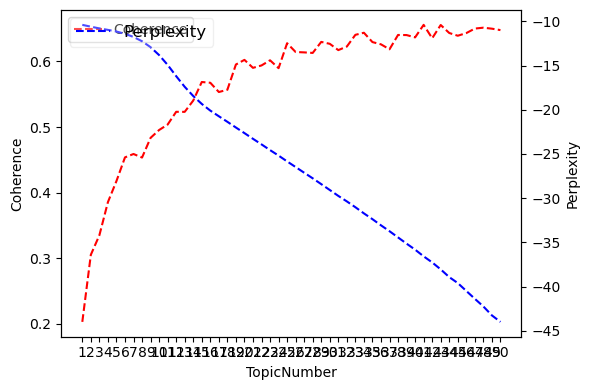

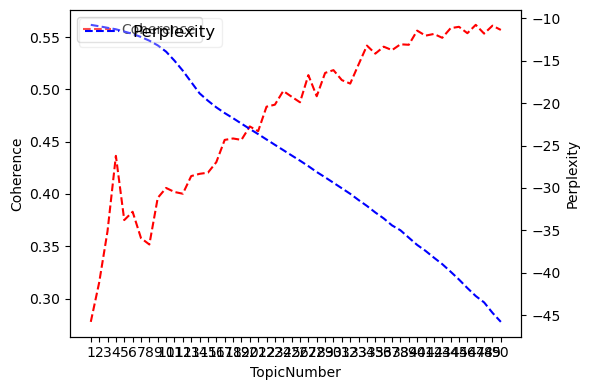

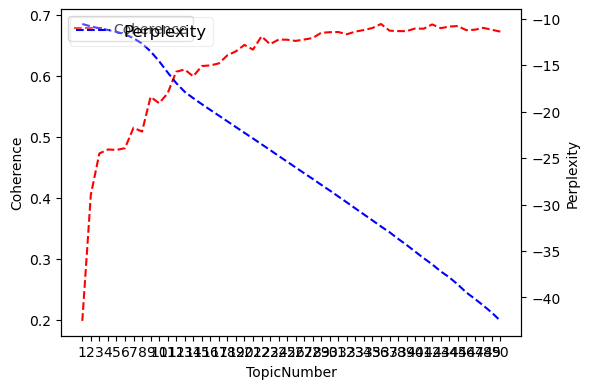

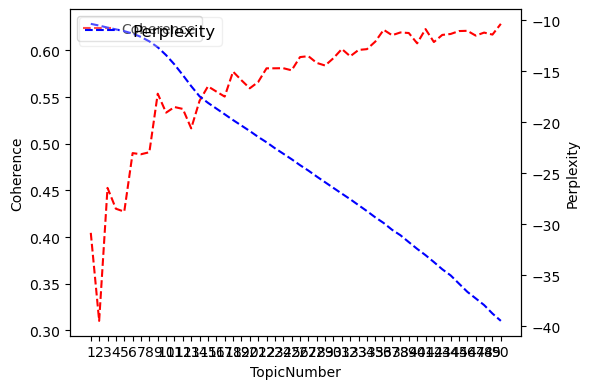

In [5]:
SUB_CRITERIA = 'Category'

for categ in tqdm(df_news[SUB_CRITERIA].unique()):
    # 하위데이터 분리
    df_sub = df_news.groupby(SUB_CRITERIA).get_group(categ)[['일자', '제목']].reset_index().iloc[:,1:]
    
    # 주체 추출
    topic_kw, doc_topic, model = modeling_LDA(df_sub['제목'], opt_numtopics=True, num_topicwords=10, num_relatedtopic=10,
                                              save_local=True, save_name='Topics_'+categ+'_byLDA.csv')

## 검색키워드에 따라

  4%|██▉                                                                             | 1/27 [03:12<1:23:30, 192.69s/it]

노인+사고


2023-11-01 13:23:48,491	INFO worker.py:1453 -- Calling ray.init() again after it has already been called.
2023-11-01 13:23:51,051	ERROR worker.py:405 -- Unhandled error (suppress with 'RAY_IGNORE_UNHANDLED_ERRORS=1'): ray::modeling_LDA_OptNTopic() (pid=25824, ip=127.0.0.1)
  File "python\ray\_raylet.pyx", line 1424, in ray._raylet.execute_task
  File "C:\DataScience\Module\algorithm_textmining.py", line 9, in modeling_LDA_OptNTopic
    coherence = model_coherence.get_coherence()
                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\user\anaconda3\Lib\site-packages\gensim\models\coherencemodel.py", line 614, in get_coherence
    confirmed_measures = self.get_coherence_per_topic()
                         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\user\anaconda3\Lib\site-packages\gensim\models\coherencemodel.py", line 574, in get_coherence_per_topic
    self.estimate_probabilities(segmented_topics)
  File "C:\Users\user\anaconda3\Lib\site-packages\gensim\models\coherencem

2023-11-01 13:23:52,053	ERROR worker.py:405 -- Unhandled error (suppress with 'RAY_IGNORE_UNHANDLED_ERRORS=1'): ray::modeling_LDA_OptNTopic() (pid=15152, ip=127.0.0.1)
  File "python\ray\_raylet.pyx", line 1424, in ray._raylet.execute_task
  File "C:\DataScience\Module\algorithm_textmining.py", line 9, in modeling_LDA_OptNTopic
    coherence = model_coherence.get_coherence()
                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\user\anaconda3\Lib\site-packages\gensim\models\coherencemodel.py", line 614, in get_coherence
    confirmed_measures = self.get_coherence_per_topic()
                         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\user\anaconda3\Lib\site-packages\gensim\models\coherencemodel.py", line 574, in get_coherence_per_topic
    self.estimate_probabilities(segmented_topics)
  File "C:\Users\user\anaconda3\Lib\site-packages\gensim\models\coherencemodel.py", line 546, in estimate_probabilities
    self._accumulator = self.measure.prob(**kwargs)
        

Optimal Topic Number:  1


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
  7%|█████▉                                                                          | 2/27 [12:02<2:42:52, 390.90s/it]

노인+사회보장


2023-11-01 13:32:39,713	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  42


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 11%|████████▉                                                                       | 3/27 [17:12<2:21:31, 353.81s/it]2023-11-01 13:37:49,450	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  16


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 19%|██████████████▊                                                                 | 5/27 [23:10<1:25:57, 234.45s/it]

노인+의료


2023-11-01 13:43:47,733	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  1


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 22%|█████████████████▊                                                              | 6/27 [28:34<1:32:42, 264.90s/it]

노인+주택+문제


2023-11-01 13:49:12,278	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  49


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 26%|████████████████████▋                                                           | 7/27 [33:47<1:33:33, 280.68s/it]2023-11-01 13:54:25,316	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  19


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 30%|███████████████████████▋                                                        | 8/27 [39:11<1:33:11, 294.29s/it]2023-11-01 13:59:49,160	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  1


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 33%|██████████████████████████▋                                                     | 9/27 [44:37<1:31:18, 304.35s/it]

노인대상+범죄


2023-11-01 14:05:15,594	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  43


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 37%|█████████████████████████████▎                                                 | 10/27 [52:51<1:42:47, 362.79s/it]2023-11-01 14:13:32,039	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  45


 41%|███████████████████████████████▎                                             | 11/27 [1:01:46<1:50:47, 415.48s/it]2023-11-01 14:22:23,904	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  41


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 44%|██████████████████████████████████▏                                          | 12/27 [1:07:21<1:37:45, 391.01s/it]2023-11-01 14:27:59,059	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  25


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 48%|█████████████████████████████████████                                        | 13/27 [1:13:26<1:29:24, 383.17s/it]2023-11-01 14:34:04,127	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  23


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 52%|███████████████████████████████████████▉                                     | 14/27 [1:19:41<1:22:29, 380.71s/it]2023-11-01 14:40:19,045	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  3


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 59%|██████████████████████████████████████████████▊                                | 16/27 [1:26:43<51:45, 282.32s/it]

복지시설


2023-11-01 14:47:19,055	INFO worker.py:1453 -- Calling ray.init() again after it has already been called.


Optimal Topic Number:  49


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 63%|████████████████████████████████████████████████▍                            | 17/27 [1:37:37<1:05:40, 394.09s/it]2023-11-01 14:58:15,343	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  42


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 67%|████████████████████████████████████████████████████▋                          | 18/27 [1:43:51<58:11, 387.91s/it]2023-11-01 15:04:28,891	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  38


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 70%|███████████████████████████████████████████████████████▌                       | 19/27 [1:50:02<51:02, 382.87s/it]2023-11-01 15:10:39,699	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  2


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 74%|██████████████████████████████████████████████████████████▌                    | 20/27 [1:55:27<42:38, 365.44s/it]2023-11-01 15:16:04,639	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  33


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 78%|█████████████████████████████████████████████████████████████▍                 | 21/27 [2:00:57<35:28, 354.81s/it]2023-11-01 15:21:34,667	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  47


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 81%|████████████████████████████████████████████████████████████████▎              | 22/27 [2:06:20<28:46, 345.33s/it]2023-11-01 15:26:57,790	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  15


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 85%|███████████████████████████████████████████████████████████████████▎           | 23/27 [2:11:35<22:25, 336.35s/it]2023-11-01 15:32:14,100	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  15


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 89%|██████████████████████████████████████████████████████████████████████▏        | 24/27 [2:16:39<16:19, 326.44s/it]2023-11-01 15:37:16,918	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  50


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 93%|█████████████████████████████████████████████████████████████████████████▏     | 25/27 [2:23:21<11:38, 349.31s/it]2023-11-01 15:43:59,516	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  38


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
 96%|████████████████████████████████████████████████████████████████████████████   | 26/27 [2:30:07<06:06, 366.33s/it]2023-11-01 15:50:45,196	INFO worker.py:1621 -- Started a local Ray instance.


Optimal Topic Number:  22


[Kss]: too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
100%|███████████████████████████████████████████████████████████████████████████████| 27/27 [2:35:03<00:00, 344.57s/it]


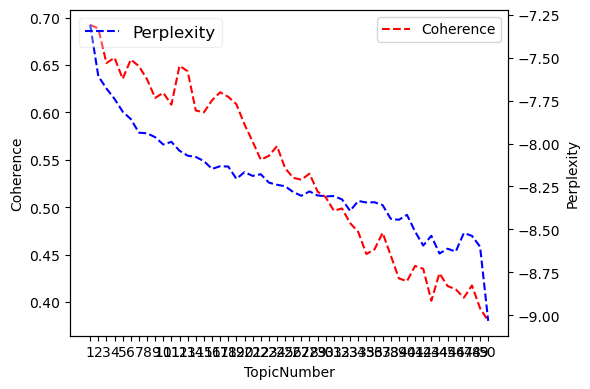

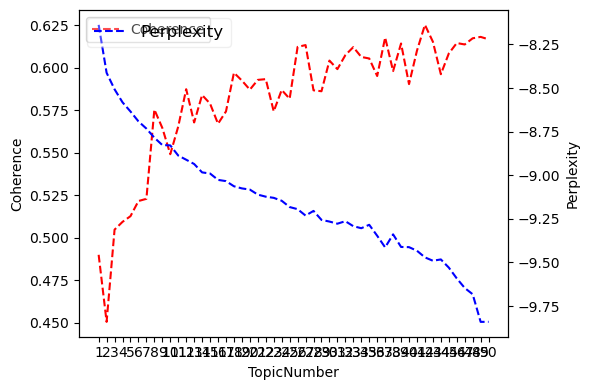

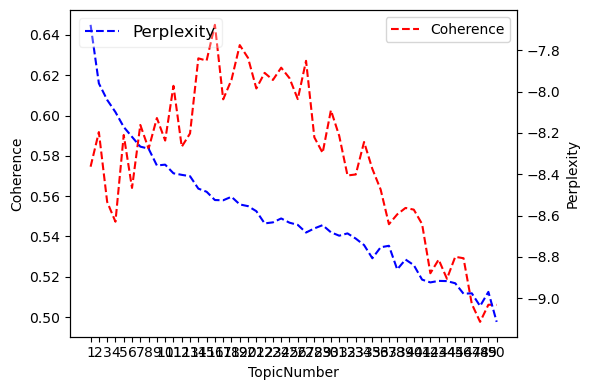

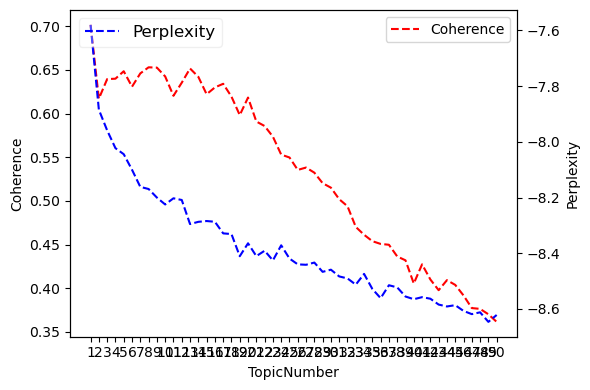

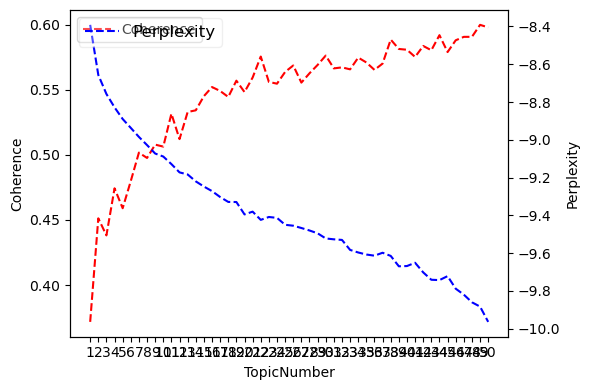

...

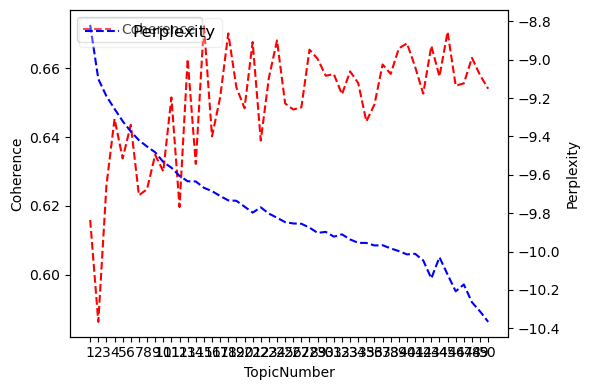

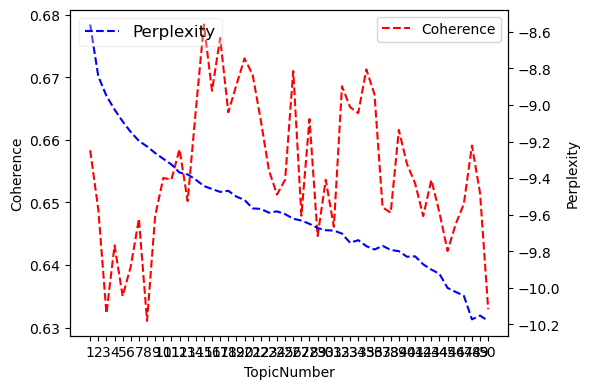

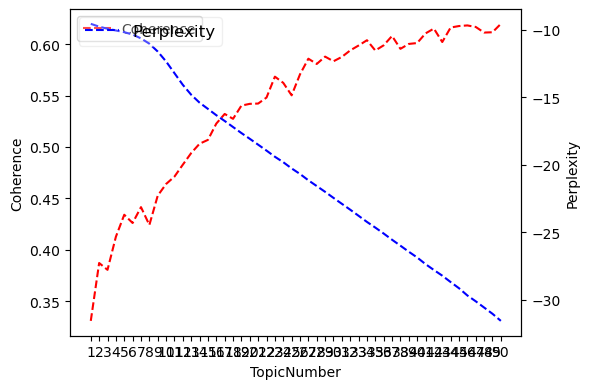

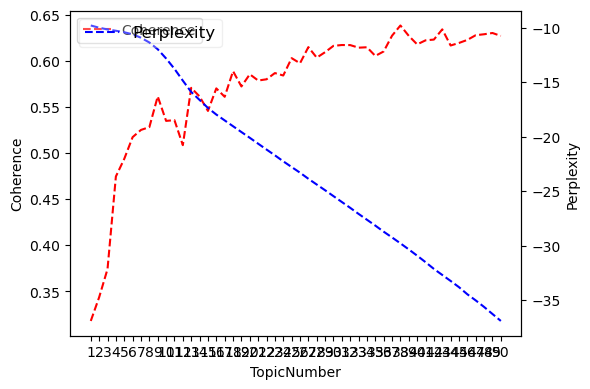

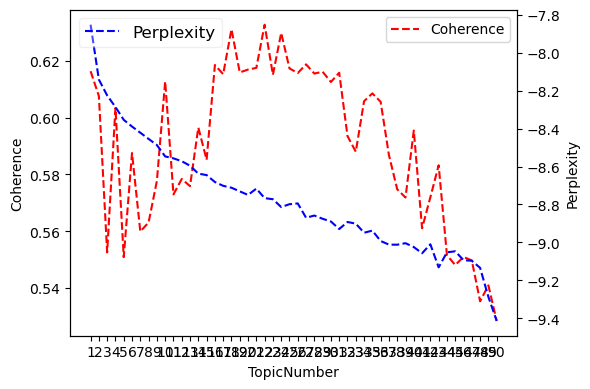

In [18]:
SUB_CRITERIA = 'Folder_Name'

for categ in tqdm(df_news[SUB_CRITERIA].unique()):
    # 하위데이터 분리
    df_sub = df_news.groupby(SUB_CRITERIA).get_group(categ)[['일자', '제목']].reset_index().iloc[:,1:]
    
    # 주체 추출
    try:
        topic_kw, doc_topic, model = modeling_LDA(df_sub['제목'], opt_numtopics=True, num_topicwords=10, num_relatedtopic=10,
                                                  save_local=True, save_name='Topics_'+categ+'_byLDA.csv')
    except:
        print(categ)
        pass

# Testing

In [ ]:
dict_news = df_news.groupby('일자_Year')['제목'].apply(list).to_dict()

ray.init(num_cpus=len(dict_news.keys()), ignore_reinit_error=True, log_to_driver=False)
task = [preprocessing_keybertParallel.remote(pd.Series(dict_news[key]), doc_topn_kwd=5) 
        for key in dict_news.keys()]
result = ray.get(task)
ray.shutdown()

In [ ]:
# https://teddylee777.github.io/huggingface/bert-kor-text-classification/

In [ ]:
from transformers import pipeline, AutoTokenizer, BertTokenizer, BertTokenizerFast
from transformers import AutoModel, AutoModelForTokenClassification, TFBertModel, TFBertForSequenceClassification

TASK = 'text-classification'
MODEL_NAME = 'monologg/kobert' # 'bert-base-multilingual-cased'
SENTENCES = df_news['제목'].to_list()[:2]
SEQ_LEN = 32

tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)
tokenizer(SENTENCES, max_length=SEQ_LEN, 
          padding='max_length', truncation=True, return_tensors='pt')

# model_sa = pipeline(task=TASK, model=MODEL_NAME)
# result = model_sa(df_news['제목'].to_list()[:100])
# for i, j in zip(df_news['제목'].to_list()[:100], result):
#     print(i,j)

In [ ]:
MODEL_NAME = 'bert-base-multilingual-cased'
tokenizer = BertTokenizer.from_pretrained(MODEL_NAME)

X_train = preprocessing_sentence_to_BERTinput(df_news['제목'][:100], tokenizer=tokenizer)

def modeling_BERTsentiment(model_name, optimizer, seq_len=128):
    # 입력 변환
    tokens = tf.keras.layers.Input((seq_len,), dtype=tf.int32, name='input_ids')
    masks = tf.keras.layers.Input((seq_len,), dtype=tf.int32, name='input_masks')
    segments = tf.keras.layers.Input((seq_len,), dtype=tf.int32, name='input_segments')
    
    # 모델 로딩
    model = TFBertModel.from_pretrained(model_name)
    outputs = model([tokens, masks, segments])[1]
    
    # 모델 구성
    layer = tf.keras.layers.Dense(1, activation='sigmoid', 
                                  kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02))(outputs)
    model_sentiment = tf.keras.Model([tokens, masks, segments], layer)
    model_sentiment.compile(optimizer=optimizer, loss=tf.keras.losses.BinaryCrossentropy(), metrics = ['accuracy'])
    
    return model_sentiment

In [ ]:
# https://towardsdatascience.com/chord-diagrams-of-protein-interaction-networks-in-python-9589affc8b91
    
import nxviz as nv
from nxviz import annotate, highlights
from nxviz.plots import despine, rescale, respine

def plot_nxviz(df_freq, df_pairweight, filter_criteria=None):
    pass

G, centrality_total = plot_networkx(FREQ_USING, df_word_corrpair, filter_criteria=None, plot=False)
ax = nv.circos(G, group_by="group_node", node_color_by="group_node")
annotate.circos_labels(G, group_by="group_node", radius=np.pi)
annotate.node_colormapping(G, color_by='group_node')
# annotate.node_labels(G, group_by="group_node", sort_by='score')
annotate.circos_group(G, group_by="group_node")